# Final Project Submission

Please fill out:
* Student name: `Karima Chakroun`

---
This noteboke contains a data science project based on the King County House Sales dataset, which explores the impact of different features on house price to come up with some useful recommendations for home sellers/buyers in King County.

# Content
1) Load Packages and Dataset

2) Data Cleaning
   - Data types (deals with conversion of data types)
   - Missing data (handles missing values)
   
3) Data Exploration & Visualization
   - Overview of all features (using scatter_matrix plots)
   - Exploring features one by one (histograms, pie/bar charts, scatter/regression plots)
   - Correlation analysis (heatmaps)
   - Folium map (mean price per zipcode)
   
4) Multiple Regression Model
   - Model fitting and summary statistics
   - Multicollinearity (checking variance inflation factors)
   
5) Customize Plots for Business Presentation

6) Conclusions

7) Future Work

---
# 1) Import Packages and Dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf

import warnings
warnings.filterwarnings('ignore')  # to ignore seaborn warnings

plt.style.use('classic')
%matplotlib inline

pd.set_option('display.max_columns', 100)

In [2]:
# import housing price data set from csv
df = pd.read_csv('King_County_House_prices_dataset.csv')

In [3]:
# do a quick check of the number of rows (observations) and columns (features) in the data set
df.shape

(21597, 21)

---
# 2) Data Cleaning

### First look at the data

Let us first have a brief look at the data set befor we start cleaning the data.

In [4]:
# print the first 3 rows of the data set
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062


In [5]:
# show the names of all columns
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

At this point, let us also have a look at the (limited) prior information we have about each column:
* **id** - unique identified for a house
* **dateDate** - house was sold
* <span style="color:red">**pricePrice** -  is prediction target</span>
* **bedroomsNumber** -  of Bedrooms/House
* **bathroomsNumber** -  of bathrooms/bedrooms
* **sqft_livingsquare** -  footage of the home
* **sqft_lotsquare** -  footage of the lot
* **floorsTotal** -  floors (levels) in house
* **waterfront** - House which has a view to a waterfront
* **view** - Has been viewed
* **condition** - How good the condition is ( Overall )
* **grade** - overall grade given to the housing unit, based on King County grading system
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated
* **zipcode** - zip
* **lat** - Latitude coordinate
* **long** - Longitude coordinate
* **sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors
* **sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors

## Data types

In [6]:
# check some basic info for each column (e.g. data type)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
id               21597 non-null int64
date             21597 non-null object
price            21597 non-null float64
bedrooms         21597 non-null int64
bathrooms        21597 non-null float64
sqft_living      21597 non-null int64
sqft_lot         21597 non-null int64
floors           21597 non-null float64
waterfront       19221 non-null float64
view             21534 non-null float64
condition        21597 non-null int64
grade            21597 non-null int64
sqft_above       21597 non-null int64
sqft_basement    21597 non-null object
yr_built         21597 non-null int64
yr_renovated     17755 non-null float64
zipcode          21597 non-null int64
lat              21597 non-null float64
long             21597 non-null float64
sqft_living15    21597 non-null int64
sqft_lot15       21597 non-null int64
dtypes: float64(8), int64(11), object(2)
memory usage: 3.5+ MB


There are two columns of data type 'object', let's have a closer look at these two.

In [7]:
df.select_dtypes(include='object').head(3)

,date,sqft_basement
0,10/13/2014,0.0
1,12/9/2014,400.0
2,2/25/2015,0.0


Let's first look at the `date` column. It represents the date at which the house was sold. Let's convert this to the type *datetime* (to be later able to work with the day, the month and the year of when the house was sold).

In [8]:
df.date = pd.to_datetime(df.date)
df.date.head(3)

0   2014-10-13
1   2014-12-09
2   2015-02-25
Name: date, dtype: datetime64[ns]

In [9]:
# check the first and last date within the data set:
df.date.min(), df.date.max()

(Timestamp('2014-05-02 00:00:00'), Timestamp('2015-05-27 00:00:00'))

Let's also directly add columns for the day, the month and the year of the date the house was sold (to be able to use these as separate features later on).

In [10]:
date_day = df.date.apply(lambda d: d.day)
date_day.name = 'date_day'

date_month = df.date.apply(lambda d: d.month)
date_month.name = 'date_month'

date_year = df.date.apply(lambda d: d.year)
date_year.name = 'date_year'

df = pd.concat([df, date_day, date_month, date_year], axis = 1)
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,13,10,2014
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,9,12,2014
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,25,2,2015


Let's now focus on the second column of data type 'object', the feature `sqft_basement`. Looks like `sqft_basement` should be of numeric type rather than object. Let's convert it to a numeric data type like the other features representing areas, e.g. `sqft_above`, `sqft_living15`, or `sqft_lot15` (all int64). Before converting, though, we will first check the unique values in this feature.

In [11]:
sorted(df.sqft_basement.unique(), reverse=True)

['?',
 '990.0',
 '980.0',
 '970.0',
 '960.0',
 '950.0',
 '946.0',
 '940.0',
 '935.0',
 '930.0',
 '920.0',
 '915.0',
 '910.0',
 '906.0',
 '900.0',
 '90.0',
 '890.0',
 '880.0',
 '875.0',
 '870.0',
 '862.0',
 '861.0',
 '860.0',
 '850.0',
 '840.0',
 '830.0',
 '820.0',
 '810.0',
 '800.0',
 '80.0',
 '792.0',
 '790.0',
 '784.0',
 '780.0',
 '770.0',
 '768.0',
 '760.0',
 '750.0',
 '740.0',
 '730.0',
 '720.0',
 '710.0',
 '704.0',
 '700.0',
 '70.0',
 '690.0',
 '680.0',
 '670.0',
 '666.0',
 '660.0',
 '652.0',
 '650.0',
 '65.0',
 '640.0',
 '630.0',
 '620.0',
 '610.0',
 '602.0',
 '600.0',
 '60.0',
 '590.0',
 '588.0',
 '580.0',
 '570.0',
 '560.0',
 '556.0',
 '550.0',
 '540.0',
 '530.0',
 '520.0',
 '518.0',
 '516.0',
 '515.0',
 '510.0',
 '508.0',
 '506.0',
 '500.0',
 '50.0',
 '490.0',
 '4820.0',
 '480.0',
 '475.0',
 '470.0',
 '460.0',
 '450.0',
 '440.0',
 '435.0',
 '430.0',
 '420.0',
 '417.0',
 '415.0',
 '414.0',
 '4130.0',
 '410.0',
 '400.0',
 '40.0',
 '390.0',
 '380.0',
 '374.0',
 '370.0',
 '360.0',

In [12]:
df.sqft_basement.value_counts()['?']

454

Among the entires representing numbers, there are 454 entires of '?', probably reflecting missing values. Let's change these '?' to NaN and convert the whole column to float (not to int, because there is no int-version of NaN)

In [13]:
df.sqft_basement = pd.to_numeric(df.sqft_basement, errors='coerce')
df.sqft_basement.head(8)

0       0.0
1     400.0
2       0.0
3     910.0
4       0.0
5    1530.0
6       NaN
7       0.0
Name: sqft_basement, dtype: float64

## Missing data

Next, we will check the count and percentage of missing values for each feature:

In [14]:
total_missing = df.isnull().sum().sort_values(ascending=False)
percent_missing = round(total_missing / df.shape[0] * 100, 3)

missing_data = pd.concat([total_missing, percent_missing], axis=1, keys=['Total', 'Percent'])
missing_data.head(10)

missing_data[missing_data.Total>0]

,Total,Percent
yr_renovated,3842,17.790
waterfront,2376,11.002
sqft_basement,454,2.102
view,63,0.292


OK, we have missing data for the following features: `yr_renovated`, `waterfront`, `sqft_basement` and `view`.

Let's start with `sqft_basement`. Looking at the feature descriptions above, we might assume that the feature `sqft_living` is actually the sum of `sqft_above` plus `sqft_basement`. Let us check this assumption formally and by plotting.

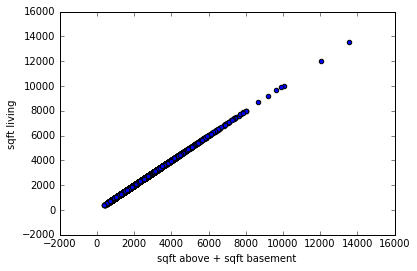

In [15]:
# Test the relationship between sqft_living, sqft_above and sqft_basement:
sqft_above_plus_basement = df.sqft_above + df.sqft_basement
sqft_living = df.sqft_living
plt.scatter(sqft_above_plus_basement, sqft_living)
plt.xlabel('sqft above + sqft basement')
plt.ylabel('sqft living');

In [16]:
# Check again if all (non-nan) entries for sqft_above_plus_basement and sqft_living are exactly the same
all(sqft_living[sqft_above_plus_basement.notna()] == sqft_above_plus_basement[sqft_above_plus_basement.notna()])

True

Hence, we note that `sqft_basement` can be calculated from `sqft_living` minus `sqft_above`. We can therefore impute the missing data for `sqft_basement` by this formula as a reasonable assumption.

In [17]:
df.loc[df.sqft_basement.isna(), 'sqft_basement'] =\
    df.sqft_living[df.sqft_basement.isna()] - df.sqft_above[df.sqft_basement.isna()]

Let's now look at `yr_renovated`.

In [18]:
df.yr_renovated.unique()

array([   0., 1991.,   nan, 2002., 2010., 1992., 2013., 1994., 1978.,
       2005., 2003., 1984., 1954., 2014., 2011., 1983., 1945., 1990.,
       1988., 1977., 1981., 1995., 2000., 1999., 1998., 1970., 1989.,
       2004., 1986., 2007., 1987., 2006., 1985., 2001., 1980., 1971.,
       1979., 1997., 1950., 1969., 1948., 2009., 2015., 1974., 2008.,
       1968., 2012., 1963., 1951., 1962., 1953., 1993., 1996., 1955.,
       1982., 1956., 1940., 1976., 1946., 1975., 1964., 1973., 1957.,
       1959., 1960., 1967., 1965., 1934., 1972., 1944., 1958.])

In [19]:
df.yr_renovated.value_counts()[0.0]

17011

We have a lot of zero entries (17011) for the `yr_renovated`. We could guess that houses, for which `yr_renovated` is zero, have not been renovated yet. We could therefore construct a new dummy variable that says if a house has been renovated yet (`yr_renovated` > 0) or not (`yr_renovated` == 0). We will also keep the nan-entries, which can be later added to the dummy-variable as an additional column (see below).

In [20]:
renovated = df.yr_renovated.copy()
renovated[renovated > 0] = 1
renovated.name = 'renovated'
 
df = pd.concat([df, renovated], axis=1)
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year,renovated
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,13,10,2014,0.0
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,9,12,2014,1.0
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,25,2,2015,NaN


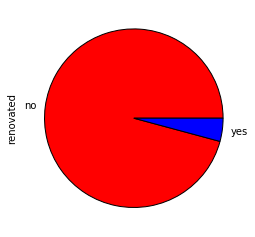

In [21]:
df.renovated.value_counts().plot(kind='pie', colors=['red','blue'], labels=['no','yes']);

In [ ]:
# ToDo: change the zeros in yr_renovated to NaN or impute with the mean

Next, we look at `waterfront`:

In [22]:
df.waterfront.unique()

array([nan,  0.,  1.])

In [23]:
df.waterfront.value_counts()

0.0    19075
1.0      146
Name: waterfront, dtype: int64

Here, the zero and nan entires seem to mean different things: nan might be interpreted as missing value, whereas 0/1 might be interpreted as no/yes regarding the question whether the house has a waterfront or not. We impute the missing waterfront-values with the waterfront-value of the nearest (non-nan) neighbor in terms of euclidean distance based on longitute and latitude.

In [24]:
# impute missing waterfront values with nearest neighbour based on longitude and latitude:
# See: https://stackoverflow.com/questions/46344762/
          # gapfilling-missing-data-at-specific-latitude-longitude-by-nearest-known-neighbou

from sklearn.metrics.pairwise import euclidean_distances

def find_closest(x, df):
    # supress itself
    d = x.drop(x.name).to_dict()
    # sort the distance
    v = sorted(d, key=lambda k: d[k])
    
    # find the closest with a non-nan waterfront value, else return nan
    for i in v :
        if i in df[~df.waterfront.isnull()].index:
            return df.loc[i].waterfront
        else:
            pass
    return np.nan

# find the geographic distance between each house and all remaining houses
df_matrix_distance = pd.DataFrame(euclidean_distances(df[["lat","long"]]))

# get the null values in waterfront
df_nan = df[df.waterfront.isnull()]
df_nan

# get the values
res = df_matrix_distance.loc[df_nan.index].apply(lambda x: find_closest(x,df), axis=1).to_dict()

# fill the values
df_raw = df.copy()
for k,v in res.items():
    df.loc[k,"waterfront"] = v

In [25]:
# old dataset (before imputation)
print(df_raw.waterfront.isna().sum())
df_raw.waterfront.value_counts()

2376


0.0    19075
1.0      146
Name: waterfront, dtype: int64

In [26]:
# new dataset (after imputation)
print(df.waterfront.isna().sum())
df.waterfront.value_counts()

0


0.0    21439
1.0      158
Name: waterfront, dtype: int64

In [27]:
# plot imputed water front values on map of King County using Bokeh and shapefile 
#!pip install bokeh

from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
import geopandas as gpd
import shapely
output_notebook()

sf = gpd.read_file('tl_2017_53033_faces/tl_2017_53033_faces.shp')    
x, y = [], []
[(x.append(list(polygon.exterior.coords.xy[0])), 
  y.append(list(polygon.exterior.coords.xy[1]))) for polygon in sf['geometry'] if type(polygon.boundary) == shapely.geometry.linestring.LineString ]

p = figure(title = "King County", plot_width = 800)
p.patches('x', 'y', source = ColumnDataSource(dict(x = x, y = y)), line_color = "white", line_width = 0.5)

# add points - see: https://stackoverflow.com/questions/43955805/bokeh-map-plot-lat-long-to-x-and-y
df_new_points = df[df_raw.waterfront.isna()]
source1 = ColumnDataSource(data=dict(longitude=df_new_points[df_new_points['waterfront'] == 0].long, 
                                     latitude=df_new_points[df_new_points['waterfront'] == 0].lat))
source2 = ColumnDataSource(data=dict(longitude=df_new_points[df_new_points['waterfront'] == 1].long, 
                                     latitude=df_new_points[df_new_points['waterfront'] == 1].lat))

p.circle(x="longitude", y="latitude", size=5, fill_color="red", fill_alpha=0.8, source=source1)
p.circle(x="longitude", y="latitude", size=5, fill_color="yellow", fill_alpha=0.8, source=source2)
show(p)

Loading BokehJS ...

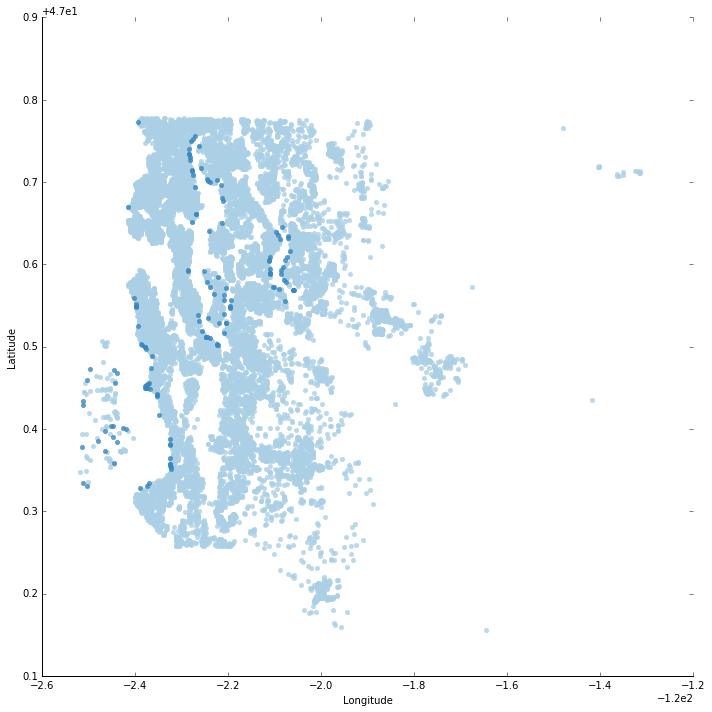

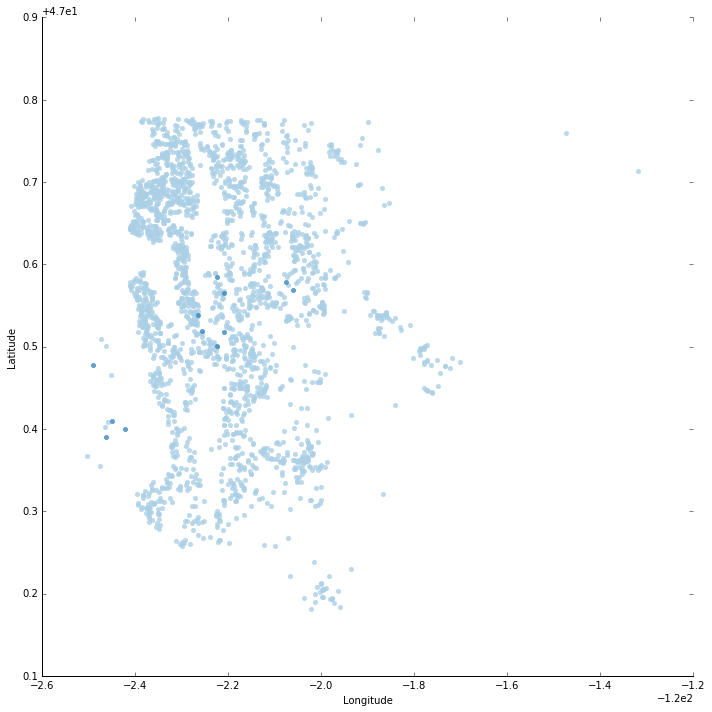

In [28]:
# Show imputed waterfront values using seaborn

# first plot: old dataframe, light blue: no waterfront, dark blue: with waterfront
sns.lmplot(y="lat", x="long", data=df_raw, height = 10, fit_reg=False, 
           hue="waterfront", legend = False, palette = "Blues")

plt.xlabel("Longitude")
plt.ylabel("Latitude")

# second plot: imputed data, light blue: no waterfront, dark blue: with waterfront
sns.lmplot(y="lat", x="long", data=df[df_raw.waterfront.isna()], height = 10, fit_reg=False, 
           hue="waterfront", legend = False, palette = "Blues")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

Finally, let's look at `view`, which returns the number of views of the house.

In [ ]:
# ToDo: research the exact meaning of the variable "view"

In [29]:
df.view.unique()

array([ 0., nan,  3.,  4.,  2.,  1.])

In [30]:
df.view.value_counts()

0.0    19422
2.0      957
3.0      508
1.0      330
4.0      317
Name: view, dtype: int64

Again, the 0. and nan entires seem to mean different things: nan might be interpreted as missing value and 0. as zero views. For the missing values (less than 1%), let's impute the mode, which is zero for view.

In [31]:
df.loc[df.view.isna(), 'view'] = 0
df.view.isna().sum()

0

After having dealt with missing data, let us summarize again the remaining number of missing values per feature.

In [32]:
df.isna().sum()

id                  0
date                0
price               0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront          0
view                0
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated     3842
zipcode             0
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
date_day            0
date_month          0
date_year           0
renovated        3842
dtype: int64

---
# 3) Data Exploration and Visualization

## Overview of all features

In [33]:
# Let's first look at some descriptive statistics
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year,renovated
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,17755.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,17755.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,0.007316,0.233181,3.409825,7.657915,1788.596842,291.725008,1970.999676,83.636778,98077.951845,47.560093,-122.213982,1986.620318,12758.283512,15.687457,6.573969,2014.322962,0.041904
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,0.085221,0.764673,0.650546,1.173200,827.759761,442.667800,29.375234,399.946414,53.513072,0.138552,0.140724,685.230472,27274.441950,8.634890,3.115061,0.467619,0.200375
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,3.000000,370.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000,1.000000,1.000000,2014.000000,0.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000,8.000000,4.000000,2014.000000,0.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000,16.000000,6.000000,2014.000000,0.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000,23.000000,9.000000,2015.000000,0.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000,31.000000,12.000000,2015.000000,1.000000


Let's look at the histograms of all features and their scatter plots with price:

### Subset1:
* **bedroomsNumber** -  of Bedrooms/House
* **bathroomsNumber** -  of bathrooms/bedrooms
* **floorsTotal** -  floors (levels) in house
* **condition** - How good the condition is ( Overall )
* **grade** - overall grade given to the housing unit, based on King County grading system

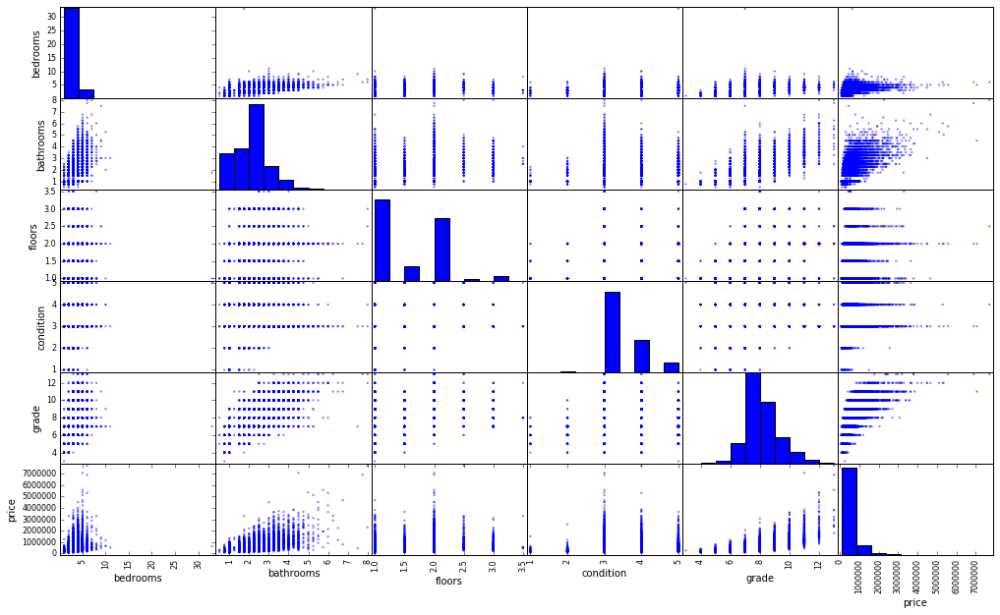

In [34]:
col_subset1 = ['bedrooms', 'bathrooms', 'floors', 'condition', 'grade', 'price']
pd.plotting.scatter_matrix(df[col_subset1], figsize=(17, 10), edgecolor='none', alpha=0.5);

From this, we can already see that there seems to be no clear linear relationship between `floors` and `price` and between `condition` and `price`. Hence, we will later do a one-hot-encoding for these two variables (see below).

**Subset2:**
* **sqft_livingsquare** -  footage of the home
* **sqft_lotsquare** -  footage of the lot
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement

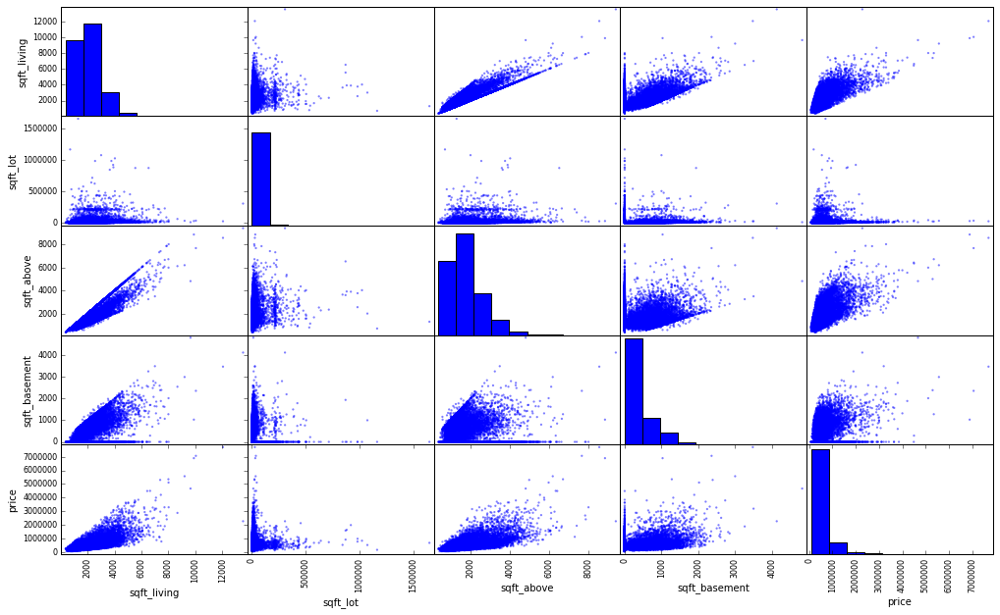

In [35]:
col_subset2 = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'price']
pd.plotting.scatter_matrix(df[col_subset2], figsize=(17, 10), edgecolor='none', alpha=0.5);

Here, we see that for `sqft_basement` it would make sense to discriminate between the cases with no basement (`sqft_basement` = 0) and between cases with basement (`sqft_basement` > 0). We will therefore create a new dummy-variable that says whether a house has a basement or not (see below).

**Subset 3:**
* **waterfront** - House which has a view to a waterfront
* **view** - Has been viewed
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated

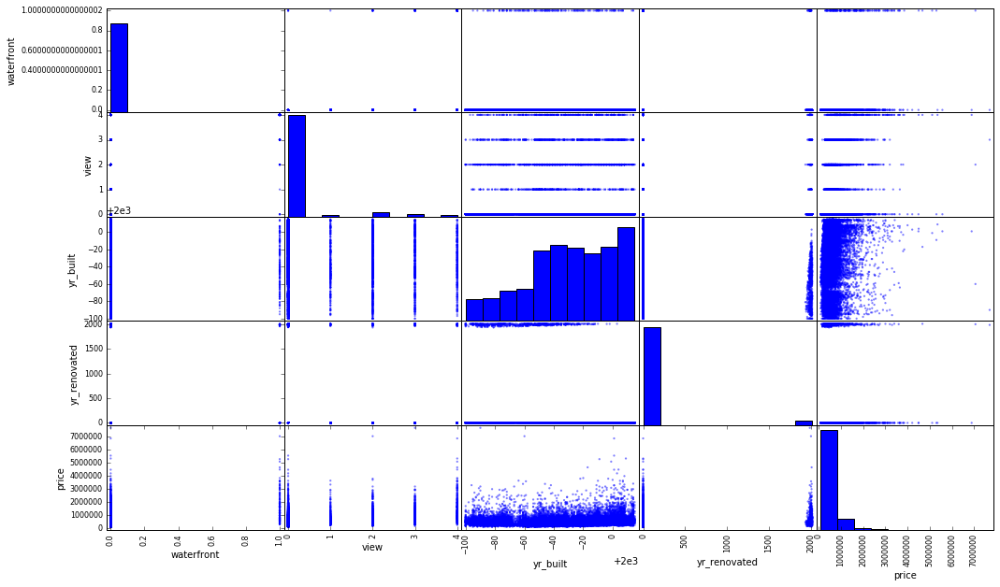

In [36]:
col_subset3 = ['waterfront', 'view', 'yr_built', 'yr_renovated', 'price']
pd.plotting.scatter_matrix(df[col_subset3], figsize=(17, 10), edgecolor='none', alpha=0.5);

Here, we already see that `waterfront` is a categorical variable, and also that there is no clear linear relationship between `view` and `price`. We might therefore also include the latter as a dummy-variable rather than as a numeric linear predictor (see below).

**Subset 4:**
* **sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors
* **sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors  
* **date_month** - month the house was sold
* **zipcode** - zip

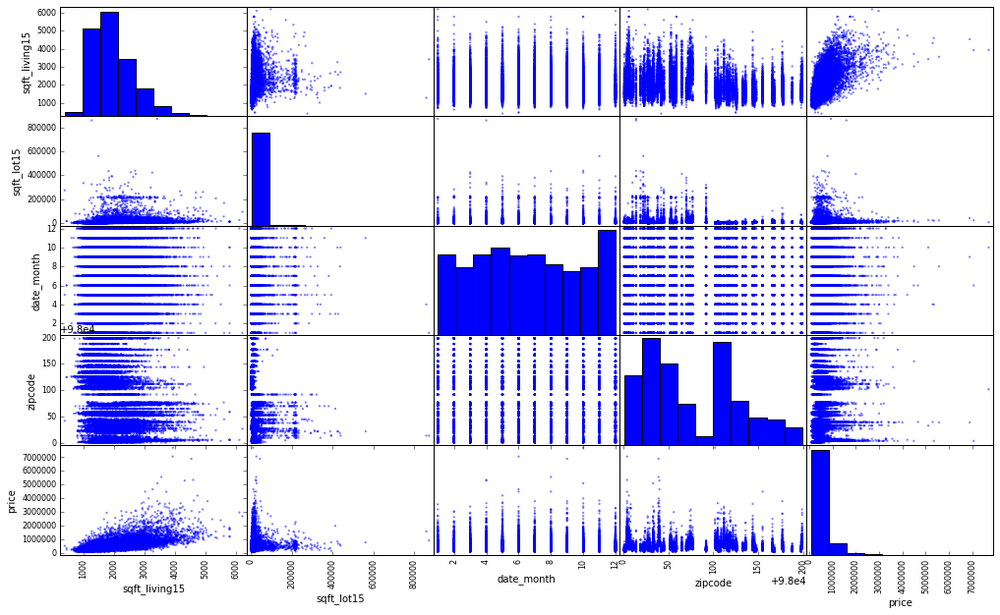

In [37]:
col_subset4 = ['sqft_living15', 'sqft_lot15', 'date_month', 'zipcode', 'price']
pd.plotting.scatter_matrix(df[col_subset4], figsize=(17, 10), edgecolor='none', alpha=0.5);

We see that we would need to dummy-encode `date_month` and `zipcode` (see below), as these are categorical variables.

## Exploring features one by one

### Price (dependent variable)

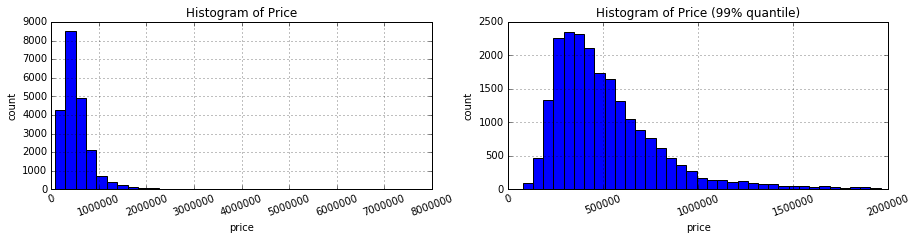

In [38]:
# Histogram

plt.subplot(121)
df.price.hist(bins=35, figsize=(15,3))
plt.title('Histogram of Price')
plt.xlabel('price')
plt.ylabel('count')
plt.xticks(rotation=20);

plt.subplot(122)
df.price[df.price < df.price.quantile(0.99)].hist(bins=35)
plt.title('Histogram of Price (99% quantile)')
plt.xlabel('price')
plt.ylabel('count')
plt.xticks(rotation=20);

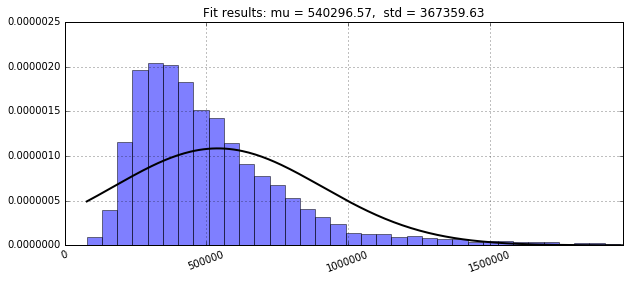

In [39]:
# Test for normal distribution
from scipy.stats import norm
μ, σ = norm.fit(df.price)

# Plot the PDF
df.price[df.price < df.price.quantile(0.99)].hist(bins=35, density=True, alpha=0.5, figsize=(10,4))
pmin, pmax = df.price.min(), df.price.max()
x = np.linspace(pmin, pmax, 1000)
p = norm.pdf(x, μ, σ)
plt.plot(x, p, 'k', linewidth=2)
plt.xticks(rotation=20)
plt.xlim(0,df.price.quantile(0.99))
title = "Fit results: mu = {:.2f},  std = {:.2f}".format(μ, σ)
plt.title(title);

Some observations made from drawing the histogram above and fitting the normal distribution to it:
- 1) The price histogram data deviates from the normal distribution.
- 2) Has positive skewness.
- 3) Demonstrates peakedness.

In [ ]:
# ToDo: Plot logarithmized price and check for normal distribution.

### Bedrooms

No handles with labels found to put in legend.


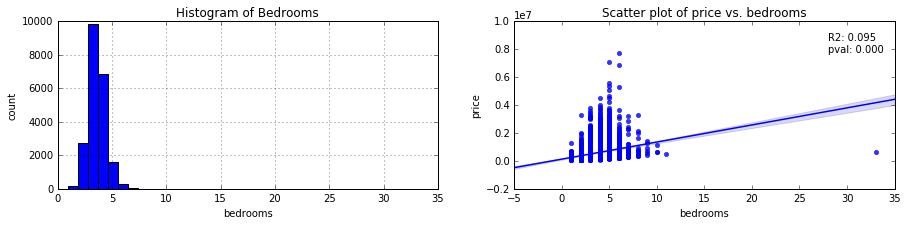

In [40]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.bedrooms.hist(bins=35, figsize=(15,3))
plt.title('Histogram of Bedrooms')
plt.xlabel('bedrooms')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ bedrooms', data=df).fit()

sns.regplot(x=df.bedrooms, y=df.price)
plt.title('Scatter plot of price vs. bedrooms')
text = 'R2: {:.3f}\npval: {:.3f}'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

In [41]:
# check the outlier for bedrooms (>30):
df.iloc[df.bedrooms.values.argmax()].bedrooms

33

No handles with labels found to put in legend.


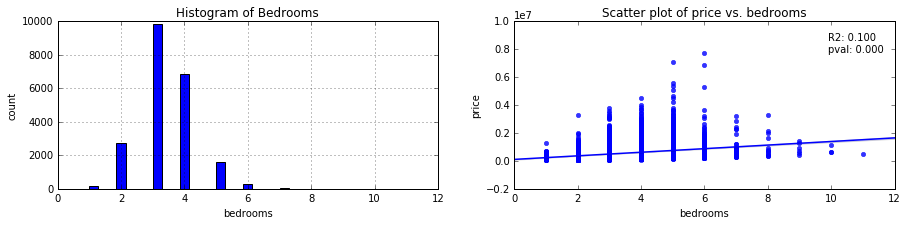

In [42]:
# let us first drop this outlier, as it might bias results
df.drop(index=15856,axis=0, inplace=True)

# and plot the data again
plt.subplot(121)
df.bedrooms.hist(bins=35, figsize=(15,3))
plt.title('Histogram of Bedrooms')
plt.xlabel('bedrooms')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ bedrooms', data=df).fit()

sns.regplot(x=df.bedrooms, y=df.price)
plt.title('Scatter plot of price vs. bedrooms')
text = 'R2: {:.3f}\npval: {:.3f}'.format(r.rsquared, r.pvalues[1])  
plt.legend(title=text, frameon=False);

We can see a slight linear relationship between `bedrooms` and `price`, although it also looks like prices are highest for houses with around 5 bedrooms and lower for houses with very little or many bedrooms. Hence, we will also check the regression output for a model with `bedrooms` as cateogircal variable.

In [43]:
# try using bedrooms as categorical predictor:
smf.ols(formula='price ~ C(bedrooms)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.106
Model:                            OLS   Adj. R-squared:                  0.106
Method:                 Least Squares   F-statistic:                     257.2
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:44:22   Log-Likelihood:            -3.0616e+05
No. Observations:               21596   AIC:                         6.123e+05
Df Residuals:                   21585   BIC:                         6.124e+05
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept          3.182e+05   2.48e+04     12.827      0.000     2.7e+05    3.67e+05
C(bedrooms)[T.2]   8.315e+04   2.57e+04      3.238      0.001    3.28e+04    1.33e+05
C(bedrooms)[T.3]    1.48e+05   2.51e+04      5.908      0.000    9.89e+04    1.97e+05
C(bedrooms)[T.4]   3.173e+05   2.52e+04     12.611      0.000    2.68e+05    3.67e+05
C(bedrooms)[T.5]   4.686e+05   2.63e+04     17.829      0.000    4.17e+05     5.2e+05
C(bedrooms)[T.6]   5.076e+05   3.25e+04     15.597      0.000    4.44e+05    5.71e+05
C(bedrooms)[T.7]   6.332e+05   6.16e+04     10.285      0.000    5.13e+05    7.54e+05
C(bedrooms)[T.8]   7.868e+05   9.95e+04      7.909      0.000    5.92e+05    9.82e+05
C(bedrooms)[T.9]   5.758e+05   1.44e+05      3.999      0.000    2.94e+05    8.58e+05
C(bedrooms)[T.10]  5.018e+05   2.02e+05      2.483      0.013    1.06e+05    8.98e+05
C(bedrooms)[T.11]  2.018e+05   3.48e+05      0.579      0.562   -4.81e+05    8.84e+05
==============================================================================
Omnibus:                    18955.510   Durbin-Watson:                   1.960
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1195850.523
Skew:                           3.946   Prob(JB):                         0.00
Kurtosis:                      38.591   Cond. No.                         171.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [44]:
# try using bedrooms as a quadratic predictor:
smf.ols(formula='price ~ bedrooms + np.power(bedrooms, 2)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.100
Model:                            OLS   Adj. R-squared:                  0.100
Method:                 Least Squares   F-statistic:                     1198.
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:44:57   Log-Likelihood:            -3.0624e+05
No. Observations:               21596   AIC:                         6.125e+05
Df Residuals:                   21593   BIC:                         6.125e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept              1.344e+05   2.11e+04      6.372      0.000     9.3e+04    1.76e+05
bedrooms               1.124e+05   1.15e+04      9.737      0.000    8.98e+04    1.35e+05
np.power(bedrooms, 2)  2204.2956   1552.646      1.420      0.156    -839.006    5247.597
==============================================================================
Omnibus:                    18892.783   Durbin-Watson:                   1.962
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1162434.072
Skew:                           3.934   Prob(JB):                         0.00
Kurtosis:                      38.070   Cond. No.                         145.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Given the results above, we will use `bedrooms` as categorical predictor for price in the multiple regression below.

In [45]:
# create bedrooms_dummy and add it to a new dataframe df_dummies
# this step might be skipped when simply using C(variable) in smf formula below,
# but we will need it to calculate the VIF for the model
# alternative: scikit learn: fit transform one hot encoder

dummy_names = ['bedrooms_dummy']
bedrooms_dummy = pd.get_dummies(df.bedrooms, prefix='bedrooms', drop_first=True)
bedrooms_dummy.head(2)

,bedrooms_2,bedrooms_3,bedrooms_4,bedrooms_5,bedrooms_6,bedrooms_7,bedrooms_8,bedrooms_9,bedrooms_10,bedrooms_11
0,0,1,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0


In [ ]:
# ToDo: plot fitted values with .predict (seaborn) in red: can the pattern of the data be reproduced? 
# ToDo: residual plot on second y axis or in extra plot
# ToDo: 2 different distributions? add interaction?

### Bathrooms

No handles with labels found to put in legend.


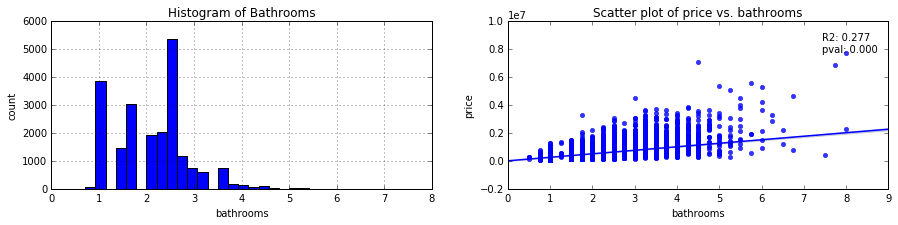

In [47]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.bathrooms.hist(bins=35, figsize=(15,3))
plt.title('Histogram of Bathrooms')
plt.xlabel('bathrooms')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ bathrooms', data=df).fit()

sns.regplot(x=df.bathrooms, y=df.price)
plt.title('Scatter plot of price vs. bathrooms')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We can see a linear relationship between `bedrooms` and `price`, hence we will consider this feature as a linear predictor in the multiple regresison model.

### Sqft_living

No handles with labels found to put in legend.


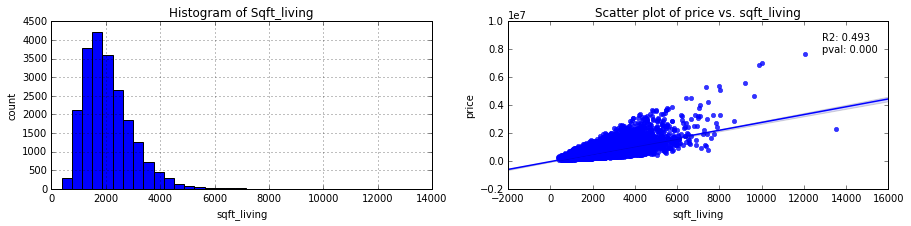

In [48]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.sqft_living.hist(bins=35, figsize=(15,3))
plt.title('Histogram of Sqft_living')
plt.xlabel('sqft_living')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_living', data=df).fit()

sns.regplot(x=df.sqft_living, y=df.price)
plt.title('Scatter plot of price vs. sqft_living')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

In [49]:
smf.ols(formula='price ~ sqft_living', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.493
Model:                            OLS   Adj. R-squared:                  0.493
Method:                 Least Squares   F-statistic:                 2.097e+04
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:46:47   Log-Likelihood:            -3.0005e+05
No. Observations:               21596   AIC:                         6.001e+05
Df Residuals:                   21594   BIC:                         6.001e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept   -4.401e+04   4410.123     -9.980      0.000   -5.27e+04   -3.54e+04
sqft_living   280.8688      1.939    144.820      0.000     277.067     284.670
==============================================================================
Omnibus:                    14801.492   Durbin-Watson:                   1.982
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           542642.481
Skew:                           2.820   Prob(JB):                         0.00
Kurtosis:                      26.901   Cond. No.                     5.63e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.63e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

We can see a strong linear relationship between `sqft_living` and `price`. In fact, this feature already explains around 50% of the variance in `price`.  Hence we will consider this feature as a linear predictor in the multiple regresison model. <br>

<h2><span style="color:red"> 
Business recommendation 1: </span> Increase the interior living area!</h2>

In [50]:
# Try also sqft_living per bedrooms as predictor:  --> lower R2 than sqft_living alone
smf.ols(formula='price ~ np.divide(sqft_living, bedrooms)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.337
Model:                            OLS   Adj. R-squared:                  0.337
Method:                 Least Squares   F-statistic:                 1.096e+04
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:50:42   Log-Likelihood:            -3.0294e+05
No. Observations:               21596   AIC:                         6.059e+05
Df Residuals:                   21594   BIC:                         6.059e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Intercept                        -7.014e+04   6176.070    -11.356      0.000   -8.22e+04    -5.8e+04
np.divide(sqft_living, bedrooms)   987.4720      9.432    104.691      0.000     968.984    1005.960
==============================================================================
Omnibus:                    16854.802   Durbin-Watson:                   1.992
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           973315.171
Skew:                           3.280   Prob(JB):                         0.00
Kurtosis:                      35.228   Cond. No.                     1.99e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.99e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [51]:
# Try also sqft_living per floor as predictor:  --> lower R2 than sqft_living alone
smf.ols(formula='price ~ np.divide(sqft_living, floors)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.187
Model:                            OLS   Adj. R-squared:                  0.187
Method:                 Least Squares   F-statistic:                     4967.
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:50:47   Log-Likelihood:            -3.0514e+05
No. Observations:               21596   AIC:                         6.103e+05
Df Residuals:                   21594   BIC:                         6.103e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==================================================================================================
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept                       1.797e+05   5591.571     32.132      0.000    1.69e+05    1.91e+05
np.divide(sqft_living, floors)   242.7723      3.445     70.475      0.000     236.020     249.524
==============================================================================
Omnibus:                    17168.329   Durbin-Watson:                   1.934
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           832785.515
Skew:                           3.446   Prob(JB):                         0.00
Kurtosis:                      32.631   Cond. No.                     4.03e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.03e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

### Sqft_lot

No handles with labels found to put in legend.


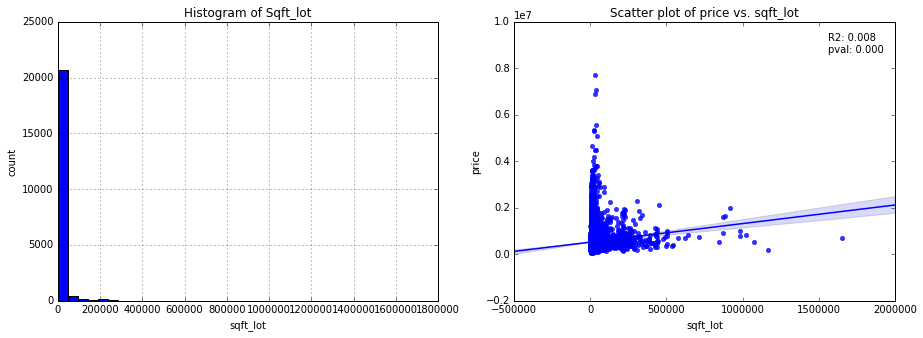

In [52]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.sqft_lot.hist(bins=35, figsize=(15,5))
plt.title('Histogram of Sqft_lot')
plt.xlabel('sqft_lot')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_lot', data=df).fit()

sns.regplot(x=df.sqft_lot, y=df.price)
plt.title('Scatter plot of price vs. sqft_lot')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We see that the distribution of `sqft_lot` is very left-skewed and there is no clear linear relationship with `price`, at least not if we include the whole range of `sqft_lot`. Let us first check the same plots for only the 95%-quantile of this feature (leaving out the 5% with largest values).

No handles with labels found to put in legend.


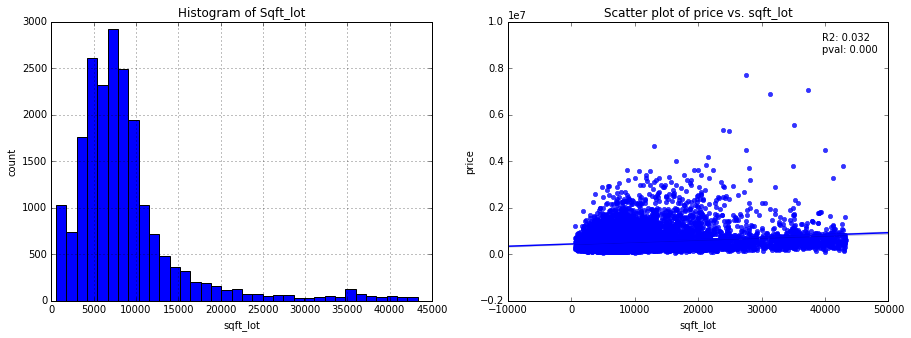

In [53]:
plt.subplot(121)
df.sqft_lot[df.sqft_lot < df.sqft_lot.quantile(0.95)].hist(bins=35, figsize=(15,5))
plt.title('Histogram of Sqft_lot')
plt.xlabel('sqft_lot')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_lot', data=df[df.sqft_lot < df.sqft_lot.quantile(0.95)]).fit()

sns.regplot(x=df.sqft_lot[df.sqft_lot < df.sqft_lot.quantile(0.95)], 
            y=df.price[df.sqft_lot < df.sqft_lot.quantile(0.95)])
plt.title('Scatter plot of price vs. sqft_lot')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Let us also try to logarithmize the feature:

No handles with labels found to put in legend.


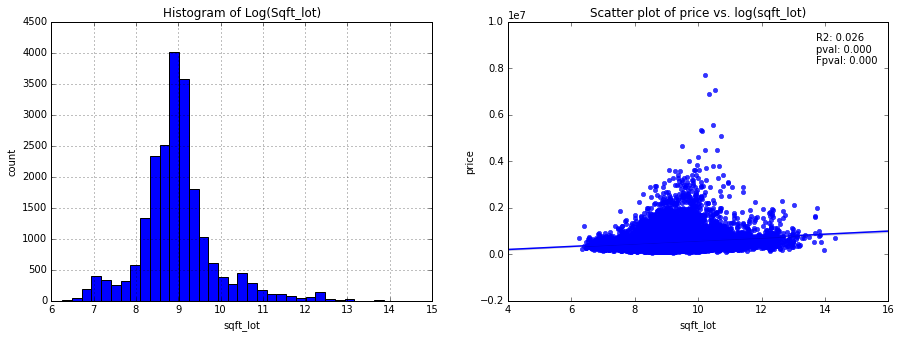

In [54]:
plt.subplot(121)
np.log(df.sqft_lot).hist(bins=35, figsize=(15,5))
plt.title('Histogram of Log(Sqft_lot)')
plt.xlabel('sqft_lot')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ np.log(sqft_lot)', data=df).fit()

sns.regplot(x=np.log(df.sqft_lot), y=df.price)
plt.title('Scatter plot of price vs. log(sqft_lot)')
text = 'R2: {:.3f}\npval: {:.3f}\nFpval: {:.3f}'.format(r.rsquared, r.pvalues[1], r.f_pvalue)
plt.legend(title=text, frameon=False);

Regarding the results above, we might consider taking the log of `sqft_lot` as a linear predictor into the model rather than the raw variable `sqft_lot`. We might also try to include an extra dummy variable for all data with a very small lot.

In [55]:
log_sqft_lot = np.log(df.sqft_lot)
log_sqft_lot.name = 'log_sqft_lot'
df = pd.concat([df, log_sqft_lot], axis=1)
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year,renovated,log_sqft_lot
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,13,10,2014,0.0,8.639411
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,9,12,2014,1.0,8.887653
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,25,2,2015,NaN,9.210340


In [56]:
# ToDo: add dummy for zero / low lot areas? with interaction term?

### Sqft_above

No handles with labels found to put in legend.


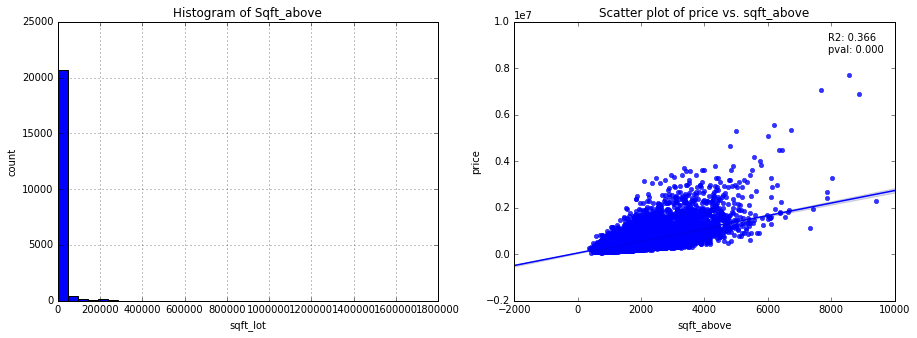

In [57]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.sqft_lot.hist(bins=35, figsize=(15,5))
plt.title('Histogram of Sqft_above')
plt.xlabel('sqft_lot')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_above', data=df).fit()

sns.regplot(x=df.sqft_above, y=df.price)
plt.title('Scatter plot of price vs. sqft_above')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We can see a linear relationship between `sqft_above` and `price`, hence we will consider this feature as a linear predictor in the multiple regresison model.

### Sqft_basement

No handles with labels found to put in legend.


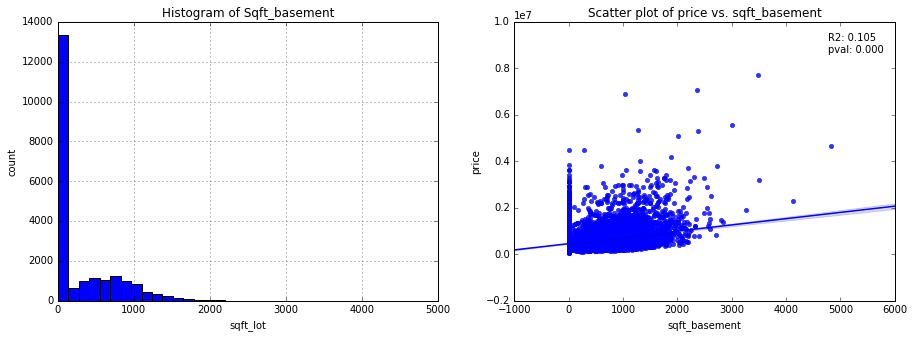

In [58]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.sqft_basement.hist(bins=35, figsize=(15,5))
plt.title('Histogram of Sqft_basement')
plt.xlabel('sqft_lot')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_basement', data=df).fit()

sns.regplot(x=df.sqft_basement, y=df.price)
plt.title('Scatter plot of price vs. sqft_basement')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Let us make an extra dummy `basement` that says if the house has a basement (1) or not (0)

In [59]:
# create basement (0/1) feature
basement = df.sqft_basement.copy()
basement[basement>0] = 1
basement.name = 'basement'
basement.head(3)

0    0.0
1    1.0
2    0.0
Name: basement, dtype: float64

In [60]:
# add this feature to dataframe
df = pd.concat([df, basement], axis=1)
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year,renovated,log_sqft_lot,basement
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,13,10,2014,0.0,8.639411,0.0
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,9,12,2014,1.0,8.887653,1.0
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,25,2,2015,NaN,9.210340,0.0


In [61]:
# Now we try a regression with both, sqft_basement and basement (without interaction)
smf.ols(formula='price ~ sqft_basement + C(basement)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.127
Model:                            OLS   Adj. R-squared:                  0.127
Method:                 Least Squares   F-statistic:                     1569.
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:52:40   Log-Likelihood:            -3.0591e+05
No. Observations:               21596   AIC:                         6.118e+05
Df Residuals:                   21593   BIC:                         6.119e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept           4.871e+05   2998.257    162.451      0.000    4.81e+05    4.93e+05
C(basement)[T.1.0] -1.946e+05   8337.622    -23.340      0.000   -2.11e+05   -1.78e+05
sqft_basement        444.5834      9.199     48.329      0.000     426.552     462.614
==============================================================================
Omnibus:                    17352.711   Durbin-Watson:                   1.947
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           772399.256
Skew:                           3.540   Prob(JB):                         0.00
Kurtosis:                      31.430   Cond. No.                     1.91e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.91e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [62]:
# ToDo: Check predictions of this model:
r = smf.ols(formula='price ~ sqft_basement + basement', data=df).fit()
r_pred = r.predict(df[['sqft_basement', 'basement']])

Based on the results above, we will use both `sqft_basement` and `basement` in the regression model.

### Floors

No handles with labels found to put in legend.


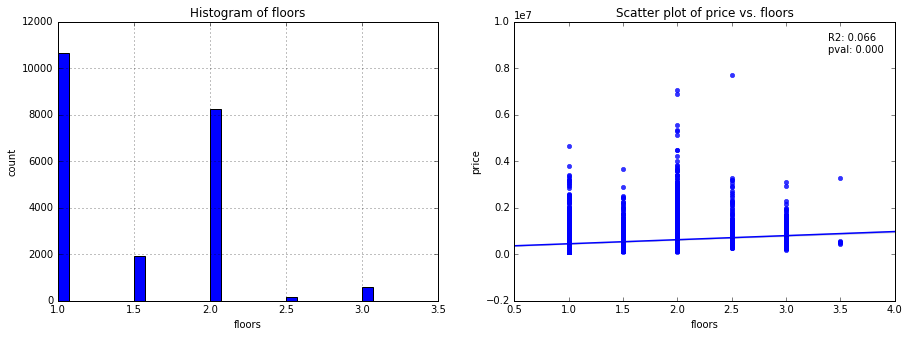

In [63]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.floors.hist(bins=35, figsize=(15,5))
plt.title('Histogram of floors')
plt.xlabel('floors')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ floors', data=df).fit()

sns.regplot(x=df.floors, y=df.price)
plt.title('Scatter plot of price vs. floors')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Since there is no clear linear relationship between `floors` and `price`, we will also check the regression output for a model with bedrooms as cateogircal variable.

In [64]:
# create floors_dummy and add it later to the dataframe df_dummies (see above why we do this)

dummy_names.append('floors_dummy')
floors_dummy = pd.get_dummies(df.floors, prefix='floor', drop_first=True)
floors_dummy.columns = [x.replace('.', '_') for x in floors_dummy.columns]
floors_dummy.head(3)

,floor_1_5,floor_2_0,floor_2_5,floor_3_0,floor_3_5
0,0,0,0,0,0
1,0,1,0,0,0
2,0,0,0,0,0


In [65]:
# test regression model with categorical floors variable: --> higher R2 than with numerical floors variable
smf.ols(formula='price ~ C(floors)', data=df).fit().summary()

# gives same output as:
# X = floors_dummies
# X = sm.add_constant(X)
# y = df.price
# sm.OLS(y, X).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.085
Model:                            OLS   Adj. R-squared:                  0.084
Method:                 Least Squares   F-statistic:                     398.9
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:53:25   Log-Likelihood:            -3.0642e+05
No. Observations:               21596   AIC:                         6.129e+05
Df Residuals:                   21590   BIC:                         6.129e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Intercept         4.423e+05   3402.924    129.988      0.000    4.36e+05    4.49e+05
C(floors)[T.1.5]  1.167e+05   8733.945     13.362      0.000    9.96e+04    1.34e+05
C(floors)[T.2.0]  2.068e+05   5156.224     40.116      0.000    1.97e+05    2.17e+05
C(floors)[T.2.5]  6.187e+05   2.79e+04     22.164      0.000    5.64e+05    6.73e+05
C(floors)[T.3.0]  1.411e+05   1.46e+04      9.649      0.000    1.12e+05     1.7e+05
C(floors)[T.3.5]  4.679e+05   1.33e+05      3.520      0.000    2.07e+05    7.28e+05
==============================================================================
Omnibus:                    19214.032   Durbin-Watson:                   1.979
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1216243.683
Skew:                           4.036   Prob(JB):                         0.00
Kurtosis:                      38.868   Cond. No.                         60.6
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Based on the results above, we will use `floors` as categorical variable in regression model.

### Waterfront

No handles with labels found to put in legend.


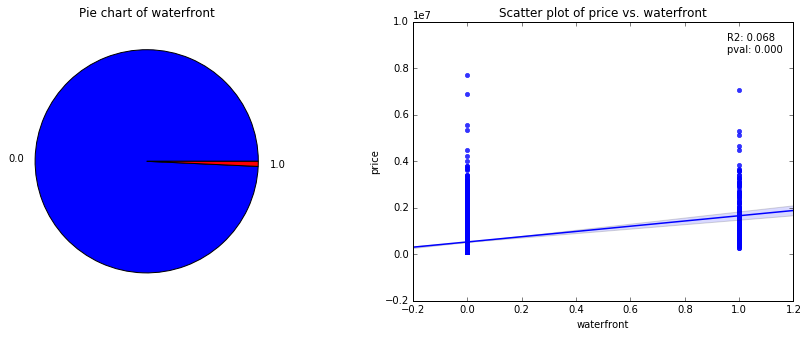

In [66]:
# Plot pie chart and scatter-plot

plt.subplot(121)
df.waterfront.value_counts().plot(kind='pie', figsize=(15,5), colors=['blue','red'])
plt.title('Pie chart of waterfront');
plt.ylabel('')

plt.subplot(122)
r = smf.ols(formula='price ~ waterfront', data=df).fit()

sns.regplot(x=df.waterfront, y=df.price)
plt.title('Scatter plot of price vs. waterfront')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Since `waterfront` is a categorical variable, we will insert this as categorical variable in the regression model.

### View

No handles with labels found to put in legend.


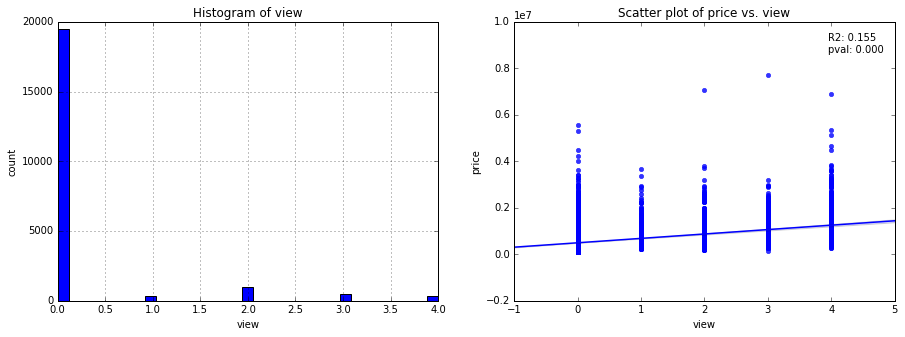

In [67]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.view.hist(bins=35, figsize=(15,5))
plt.title('Histogram of view')
plt.xlabel('view')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ view', data=df).fit()

sns.regplot(x=df.view, y=df.price)
plt.title('Scatter plot of price vs. view')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Since there is no clear linear relationship between `view` and `price`, we will also check the regression output for a model with view as cateogircal variable.

In [68]:
# test regression model with categorical view variable: --> higher R2 than with numerical view variable
smf.ols(formula='price ~ C(view)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.165
Model:                            OLS   Adj. R-squared:                  0.165
Method:                 Least Squares   F-statistic:                     1065.
Date:                Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                        23:53:41   Log-Likelihood:            -3.0543e+05
No. Observations:               21596   AIC:                         6.109e+05
Df Residuals:                   21591   BIC:                         6.109e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept       4.972e+05   2405.606    206.685      0.000    4.92e+05    5.02e+05
C(view)[T.1.0]  3.162e+05   1.86e+04     16.962      0.000     2.8e+05    3.53e+05
C(view)[T.2.0]  2.942e+05   1.11e+04     26.461      0.000    2.72e+05    3.16e+05
C(view)[T.3.0]  4.761e+05   1.51e+04     31.547      0.000    4.47e+05    5.06e+05
C(view)[T.4.0]  9.553e+05    1.9e+04     50.244      0.000    9.18e+05    9.93e+05
==============================================================================
Omnibus:                    17954.697   Durbin-Watson:                   1.958
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1079615.020
Skew:                           3.622   Prob(JB):                         0.00
Kurtosis:                      36.872   Cond. No.                         8.37
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Based on the results above, we will use `view` as categorical variable in regression model.

In [69]:
# create view_dummy and add it later to the dataframe df_dummies (see above why we do this)

dummy_names.append('view_dummy')
view_dummy = pd.get_dummies(df.view, prefix='view', drop_first=True)
view_dummy.columns = [x.replace('.', '_') for x in view_dummy.columns]
view_dummy.head(2)

,view_1_0,view_2_0,view_3_0,view_4_0
0,0,0,0,0
1,0,0,0,0


### Condition

No handles with labels found to put in legend.


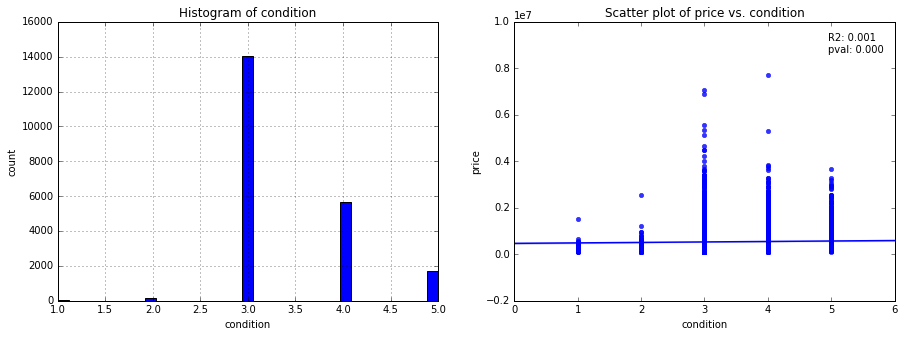

In [70]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.condition.hist(bins=35, figsize=(15,5))
plt.title('Histogram of condition')
plt.xlabel('condition')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ condition', data=df).fit()

sns.regplot(x=df.condition, y=df.price)
plt.title('Scatter plot of price vs. condition')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Since there is no clear linear relationship between `condition` and `price`, we will also check the regression output for a model with condition as cateogircal variable.

In [71]:
# test regression model with categorical condition variable: --> higher R2 than with numerical condition variable
smf.ols(formula='price ~ C(condition)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     36.84
Date:                Sun, 03 Nov 2019   Prob (F-statistic):           9.46e-31
Time:                        23:53:57   Log-Likelihood:            -3.0730e+05
No. Observations:               21596   AIC:                         6.146e+05
Df Residuals:                   21591   BIC:                         6.147e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept          3.411e+05    6.8e+04      5.016      0.000    2.08e+05    4.74e+05
C(condition)[T.2] -1.289e+04   7.36e+04     -0.175      0.861   -1.57e+05    1.31e+05
C(condition)[T.3]  2.011e+05   6.81e+04      2.955      0.003    6.77e+04    3.35e+05
C(condition)[T.4]  1.803e+05   6.82e+04      2.645      0.008    4.67e+04    3.14e+05
C(condition)[T.5]  2.715e+05   6.86e+04      3.959      0.000    1.37e+05    4.06e+05
==============================================================================
Omnibus:                    19183.573   Durbin-Watson:                   1.969
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1160631.779
Skew:                           4.043   Prob(JB):                         0.00
Kurtosis:                      37.992   Cond. No.                         75.9
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Based on the results above, we will use `condition` as categorical variable in regression model.

In [72]:
# create cond_dummy and add it later to the dataframe df_dummies (see above why we do this)
dummy_names.append('cond_dummy')
cond_dummy = pd.get_dummies(df.condition, prefix='cond', drop_first=True)
cond_dummy.head(2)

,cond_2,cond_3,cond_4,cond_5
0,0,1,0,0
1,0,1,0,0


### Grade

No handles with labels found to put in legend.


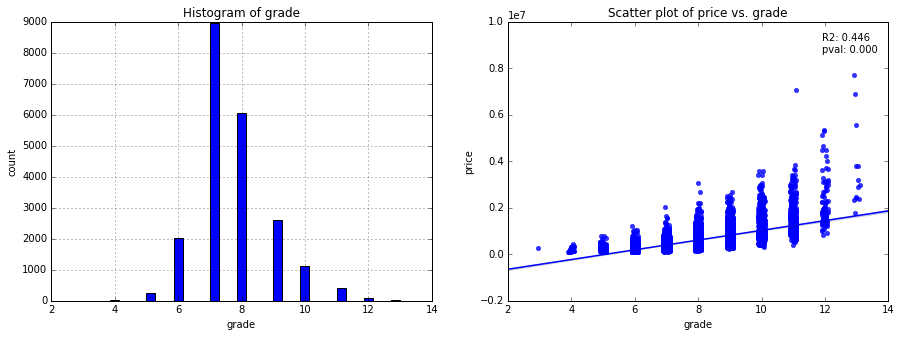

In [73]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.grade.hist(bins=35, figsize=(15,5))
plt.title('Histogram of grade')
plt.xlabel('grade')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ grade', data=df).fit()

sns.regplot(x=df.grade, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. grade')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We can see a curvature in the relationship between `grade` and `price`. Also the residual plot shows that a linear fit does not adequately describe the relationship between both variables. 

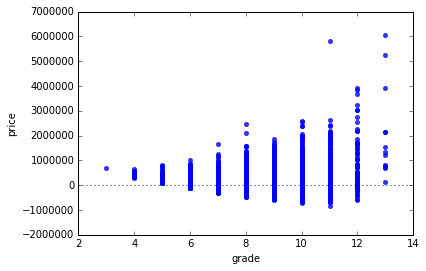

In [74]:
sns.residplot(x="grade", y="price", data=df, order=1);

Hence we will try out different degrees of polynomial regressions with this feature.

In [75]:
r1 = smf.ols(formula='price ~ grade', data=df).fit()
r2 = smf.ols(formula='price ~ grade + np.power(grade, 2)', data=df).fit()
r3 = smf.ols(formula='price ~ grade + np.power(grade, 2) + np.power(grade, 3)', data=df).fit()
r4 = smf.ols(formula='price ~ grade + np.power(grade, 2) + np.power(grade, 3) + np.power(grade, 4)', data=df).fit()

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


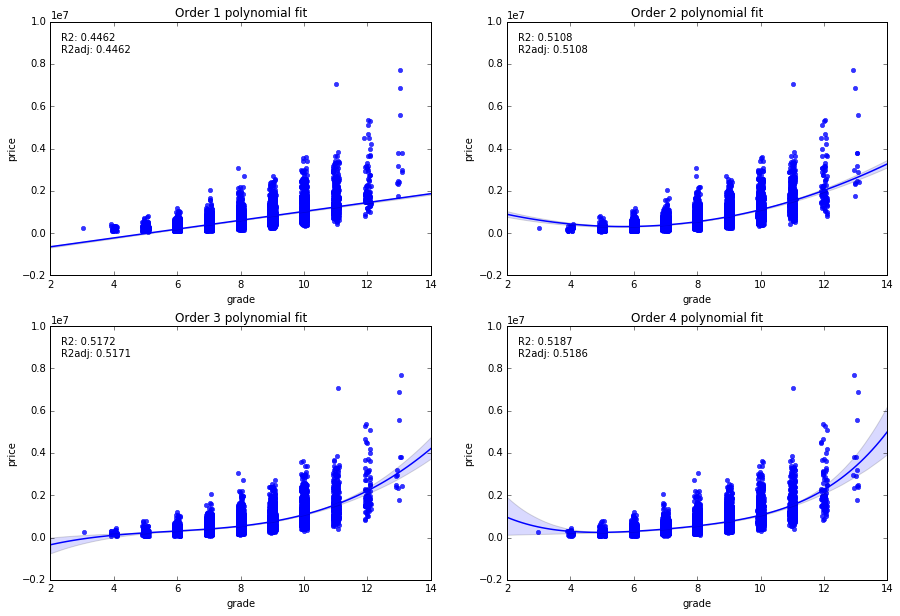

In [76]:
f, axs = plt.subplots(2,2,figsize=(15,10))
plt.subplot(221)
sns.regplot(x="grade", y="price", data=df, order=1, x_jitter=0.1)
plt.title('Order 1 polynomial fit')
plt.legend(title='R2: {:.4f}\nR2adj: {:.4f}\n'.format(r1.rsquared, r1.rsquared_adj), loc=2, frameon=False);
plt.subplot(222)
sns.regplot(x="grade", y="price", data=df, order=2, x_jitter=0.1)
plt.title('Order 2 polynomial fit');
plt.legend(title='R2: {:.4f}\nR2adj: {:.4f}\n'.format(r2.rsquared, r2.rsquared_adj), loc=2, frameon=False);
plt.subplot(223)
sns.regplot(x="grade", y="price", data=df, order=3, x_jitter=0.1)
plt.title('Order 3 polynomial fit');
plt.legend(title='R2: {:.4f}\nR2adj: {:.4f}\n'.format(r3.rsquared, r3.rsquared_adj), loc=2, frameon=False);
plt.subplot(224)
sns.regplot(x="grade", y="price", data=df, order=4, x_jitter=0.1)
plt.title('Order 4 polynomial fit')
plt.legend(title='R2: {:.4f}\nR2adj: {:.4f}\n'.format(r4.rsquared, r4.rsquared_adj), loc=2, frameon=False);

Conclusion: Include order-2-polynomial of grade in later regression model.

<h2><span style="color:red"> 
Business recommendation 2: </span> Increase the house's grade!</h2>

### Year_built

No handles with labels found to put in legend.


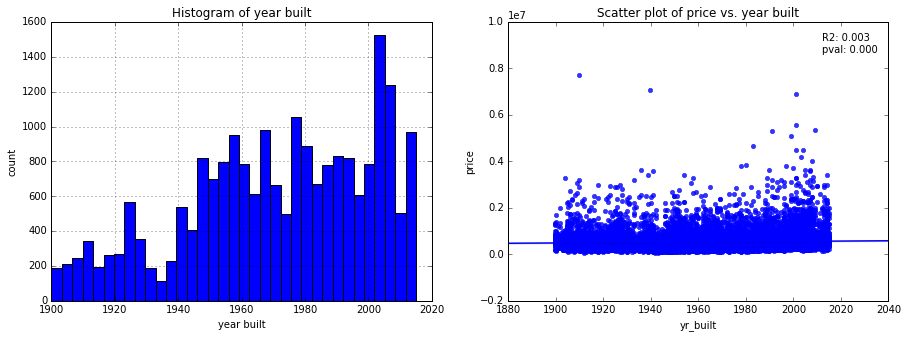

In [77]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.yr_built.hist(bins=35, figsize=(15,5))
plt.title('Histogram of year built')
plt.xlabel('year built')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ yr_built', data=df).fit()

sns.regplot(x=df.yr_built, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. year built')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

There is no clear linear relationship between `yr_built` and `price`. Let us try to group the year build variable into decades.

In [78]:
decades = np.arange(1900, 2030, 10)
decade_built = pd.cut(df.yr_built, bins=decades, labels= [str(d) + "s" for d in decades[:-1]])
decade_built.name = 'decade_built'
df = pd.concat([df, decade_built], axis=1)
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year,renovated,log_sqft_lot,basement,decade_built
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,13,10,2014,0.0,8.639411,0.0,1950s
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,9,12,2014,1.0,8.887653,1.0,1950s
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,25,2,2015,NaN,9.210340,0.0,1930s
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000,9,12,2014,0.0,8.517193,1.0,1960s
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503,18,2,2015,0.0,8.997147,0.0,1980s


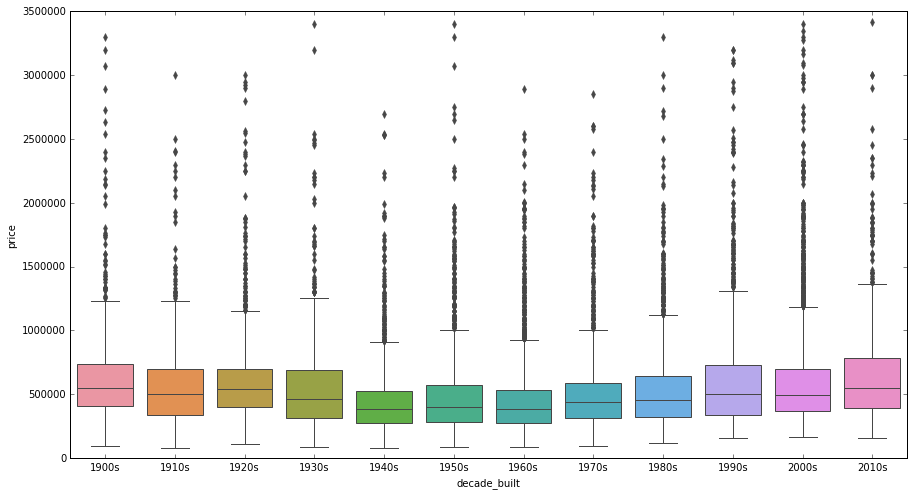

In [79]:
f, ax = plt.subplots(figsize=(15, 8))
fig = sns.boxplot(x='decade_built', y='price', data=df)
fig.axis(ymin=0, ymax=3500000);

Looks like the `decade_built` could have some non-linear relationship with `price`. Let us try a regresion model with the categorical variable `dedade_built` instead of the numerical variable `yr_built`.

In [80]:
smf.ols(formula='price ~ decade_built', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.034
Model:                            OLS   Adj. R-squared:                  0.034
Method:                 Least Squares   F-statistic:                     69.24
Date:                Sun, 03 Nov 2019   Prob (F-statistic):          2.05e-153
Time:                        23:56:07   Log-Likelihood:            -3.0578e+05
No. Observations:               21509   AIC:                         6.116e+05
Df Residuals:                   21497   BIC:                         6.117e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept              6.476e+05   1.37e+04     47.137      0.000    6.21e+05    6.74e+05
decade_built[T.1910s] -8.836e+04   1.89e+04     -4.666      0.000   -1.25e+05   -5.12e+04
decade_built[T.1920s] -4.121e+04   1.73e+04     -2.383      0.017   -7.51e+04   -7316.438
decade_built[T.1930s] -5.162e+04   2.02e+04     -2.556      0.011   -9.12e+04    -1.2e+04
decade_built[T.1940s] -2.064e+05   1.61e+04    -12.822      0.000   -2.38e+05   -1.75e+05
decade_built[T.1950s] -1.702e+05   1.56e+04    -10.940      0.000   -2.01e+05    -1.4e+05
decade_built[T.1960s] -1.915e+05   1.55e+04    -12.358      0.000   -2.22e+05   -1.61e+05
decade_built[T.1970s] -1.502e+05   1.56e+04     -9.627      0.000   -1.81e+05    -1.2e+05
decade_built[T.1980s]  -1.12e+05   1.56e+04     -7.169      0.000   -1.43e+05   -8.14e+04
decade_built[T.1990s] -5.084e+04   1.58e+04     -3.216      0.001   -8.18e+04   -1.99e+04
decade_built[T.2000s]  -4.12e+04   1.51e+04     -2.737      0.006   -7.07e+04   -1.17e+04
decade_built[T.2010s] -2756.1893   1.75e+04     -0.157      0.875   -3.71e+04    3.16e+04
==============================================================================
Omnibus:                    19191.102   Durbin-Watson:                   1.973
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1174866.029
Skew:                           4.069   Prob(JB):                         0.00
Kurtosis:                      38.281   Cond. No.                         20.7
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Based on the above results, we might consider including `decade_built` as a categorical varialbe in the regression model.

In [81]:
# create decade_dummy and add it later to the dataframe df_dummies (see above why we do this)
dummy_names.append('decade_dummy')
decade_dummy = pd.get_dummies(df.decade_built, prefix='decade', drop_first=True)
decade_dummy.head(2)

,decade_1910s,decade_1920s,decade_1930s,decade_1940s,decade_1950s,decade_1960s,decade_1970s,decade_1980s,decade_1990s,decade_2000s,decade_2010s
0,0,0,0,0,1,0,0,0,0,0,0
1,0,0,0,0,1,0,0,0,0,0,0


### Year_renovated

Let's first consider the variable `yr_renovated`, but without the zero entries.

No handles with labels found to put in legend.


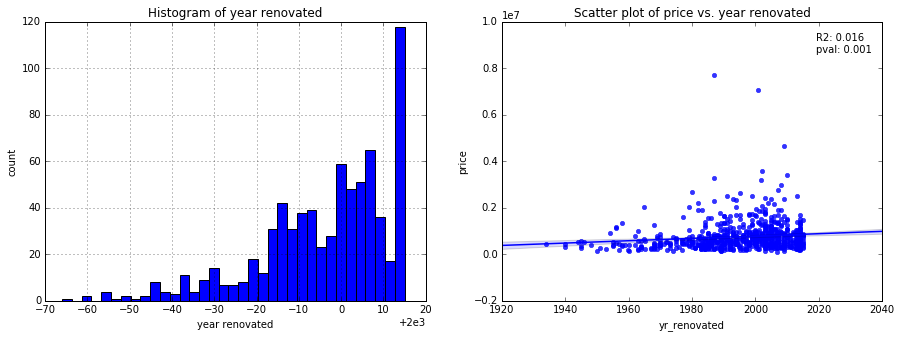

In [82]:
# Plot histogram and scatter-plot

plt.subplot(121)
df[df.renovated==1].yr_renovated.hist(bins=35, figsize=(15,5))
plt.title('Histogram of year renovated')
plt.xlabel('year renovated')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ yr_renovated', data=df[df.renovated==1]).fit()

sns.regplot(x=df[df.renovated==1].yr_renovated, y=df[df.renovated==1].price, x_jitter=0.1)
plt.title('Scatter plot of price vs. year renovated')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Let's now consider the categorical variable `renovated` (yes/no).

No handles with labels found to put in legend.


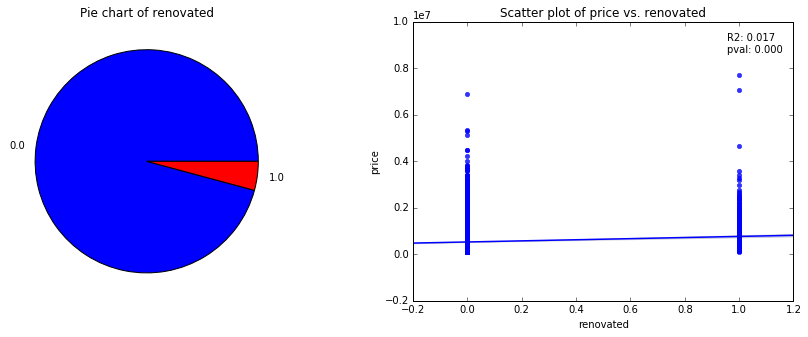

In [83]:
# Plot pie chart and scatter-plot

plt.subplot(121)
df.renovated.value_counts().plot(kind='pie', figsize=(15,5), colors=['blue','red'])
plt.title('Pie chart of renovated');
plt.ylabel('')

plt.subplot(122)
r = smf.ols(formula='price ~ renovated', data=df).fit()

sns.regplot(x=df.renovated, y=df.price)
plt.title('Scatter plot of price vs. renovated')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

In [84]:
smf.ols(formula='price ~ renovated', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.017
Method:                 Least Squares   F-statistic:                     301.6
Date:                Sun, 03 Nov 2019   Prob (F-statistic):           5.18e-67
Time:                        23:56:44   Log-Likelihood:            -2.5264e+05
No. Observations:               17754   AIC:                         5.053e+05
Df Residuals:                   17752   BIC:                         5.053e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   5.307e+05   2807.972    188.987      0.000    5.25e+05    5.36e+05
renovated   2.382e+05   1.37e+04     17.368      0.000    2.11e+05    2.65e+05
==============================================================================
Omnibus:                    15959.039   Durbin-Watson:                   1.956
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1018676.882
Skew:                           4.100   Prob(JB):                         0.00
Kurtosis:                      39.191   Cond. No.                         5.00
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Since we know from above that we have many missing values for `yr_renovated` and `renovated`, we can construct a dummy variable than includes a column for missing values

In [85]:
# create renovated_dummy including a column for missing values and add it later to df_dummies

dummy_names.append('renov_dummy')
renov_dummy = pd.get_dummies(df.renovated, prefix='renov', drop_first=True, dummy_na = True)
renov_dummy.columns = ['renov_1', 'renova_nan']
renov_dummy.head(3)

,renov_1,renova_nan
0,0,0
1,1,0
2,0,1


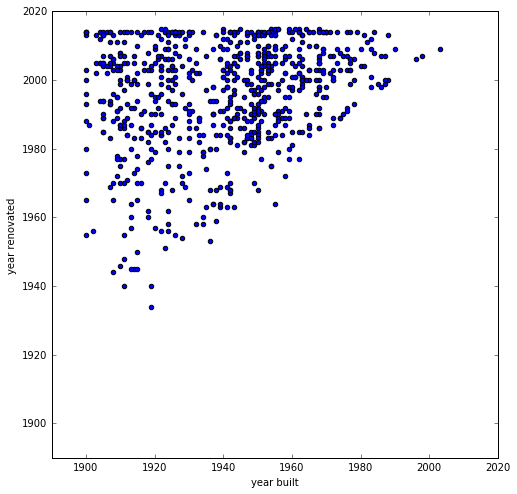

In [86]:
# Let's also check how yr_renovated relates to yr_built (first for all houses where yr_renovated > 0)

fig, ax = plt.subplots(figsize=(8,8))
plt.scatter(df.yr_built[df.yr_renovated > 0], df.yr_renovated[df.yr_renovated > 0])
ax.ticklabel_format(useOffset=False)
plt.axis('equal')
plt.xlim(1890, 2020)
plt.ylim(1890, 2020);
plt.xlabel('year built')
plt.ylabel('year renovated');

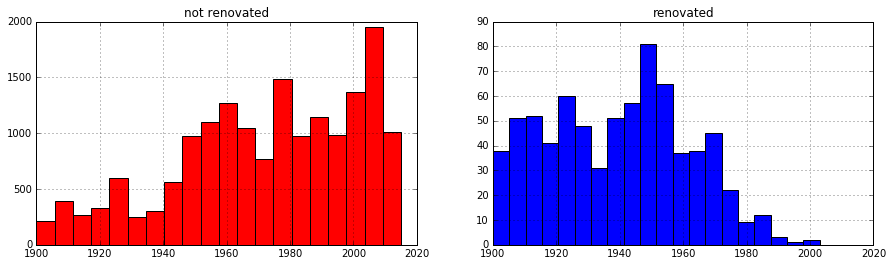

In [87]:
# Let's further check the distribution of yr_built for all houses where yr_renovated either zero or non-zero:

plt.subplot(121)
df.yr_built[df.yr_renovated == 0].hist(bins=20, figsize=(15,4), color='red')
plt.title('not renovated')
ylim1 = plt.gca().get_ylim() 

plt.subplot(122)
df.yr_built[df.yr_renovated > 0].hist(bins=20, color='blue')
#plt.ylim(ylim1)
plt.title('renovated');

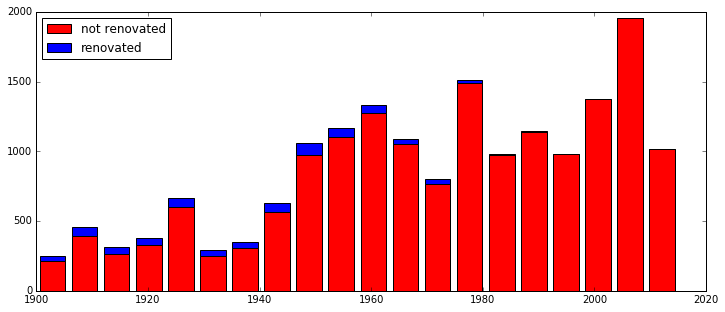

In [88]:
# Stacked histogram of renovated and non-renovated houses over the years the houses were built

fig, ax = plt.subplots(figsize=(12,5))
plt.hist([df.yr_built[df.yr_renovated == 0], df.yr_built[df.yr_renovated > 0]],
          stacked=True, color = ['r','b'], bins=20)
plt.legend(labels=['not renovated', 'renovated'], loc='upper left');

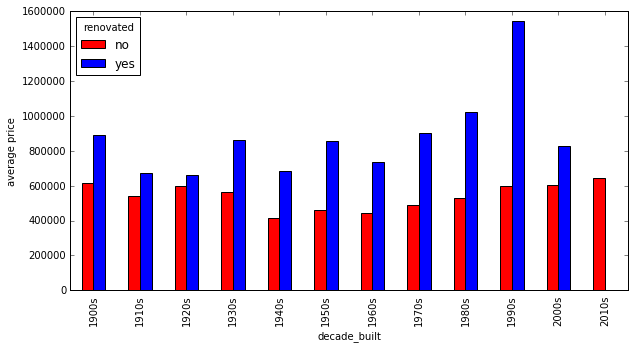

In [89]:
# Check the relationship between decade_built, renovation status (yes/no) and price:

#pd.crosstab(df.decade_built, df.renovated, values=df.price, aggfunc=np.mean).plot(kind='bar')
pd.pivot_table(data=df, values='price', index='decade_built', 
               columns='renovated', aggfunc=np.mean).plot(kind='bar', color=['red','blue'], figsize=(10,5))
plt.ylabel('average price')
plt.legend(title='renovated', labels=['no','yes'], loc='upper left');

In [91]:
# t-test for mean price difference between renovated and non-renovated houses
import scipy
from scipy import stats
scipy.stats.ttest_ind(df.price[df.renovated==0], df.price[df.renovated==1], equal_var=False,
                      nan_policy='omit') # axis=0,

Ttest_indResult(statistic=-10.291631118428908, pvalue=2.3743412965038705e-23)

In [92]:
# calculate mean price difference between renovated and non-renovated houses:
df.price[df.renovated==1].mean() - df.price[df.renovated==0].mean()

238230.78388993186

We can see that there is a significant price different between renovated and non-renovated houses: On average, renovated houses bring around $ 238 000 more than non-renovated houses.

<h2><span style="color:red"> 
Business recommendation 3: </span> Renovate the house!</h2>

We can additionally construct a variable `yr_decay` that counts the years between the house was sold (`date_year`) and the year since the house was built (`yr_built` for non-renovated houses) or last renovated (`yr_renovated` for renovated houses).

In [93]:
yr_decay = df.date_year - df.yr_built          
yr_decay[df.yr_renovated>0] = df.date_year[df.yr_renovated>0] - df.yr_renovated[df.yr_renovated>0]
yr_decay.name = 'yr_decay'

# Add this variable to the dataframe:
df = pd.concat([df, yr_decay], axis=1)
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_day,date_month,date_year,renovated,log_sqft_lot,basement,decade_built,yr_decay
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,13,10,2014,0.0,8.639411,0.0,1950s,59
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,9,12,2014,1.0,8.887653,1.0,1950s,23
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,25,2,2015,NaN,9.210340,0.0,1930s,82


No handles with labels found to put in legend.


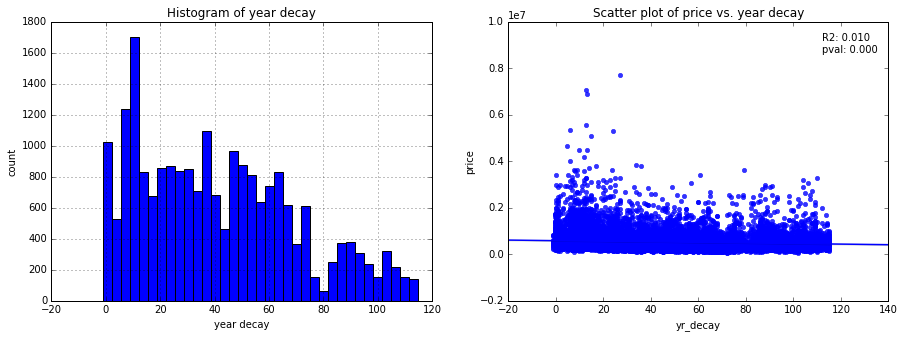

In [94]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.yr_decay.hist(bins=35, figsize=(15,5))
plt.title('Histogram of year decay')
plt.xlabel('year decay')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ yr_decay', data=df).fit()

sns.regplot(x=df.yr_decay, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. year decay')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

In [95]:
# We have one negative value in there (# 1761), let's check the corresponding observation:
df.iloc[yr_decay.values.argmin()]   # it was sold (2014) before it was built (2015)  :)

id                        1832100030
date             2014-06-25 00:00:00
price                         597326
bedrooms                           4
bathrooms                          4
sqft_living                     3570
sqft_lot                        8250
floors                             2
waterfront                         0
view                               0
condition                          3
grade                             10
sqft_above                      2860
sqft_basement                    710
yr_built                        2015
yr_renovated                     NaN
zipcode                        98040
lat                          47.5784
long                        -122.226
sqft_living15                   2230
sqft_lot15                     10000
date_day                          25
date_month                         6
date_year                       2014
renovated                        NaN
log_sqft_lot                 9.01797
basement                           1
d

### Zipcode

No handles with labels found to put in legend.


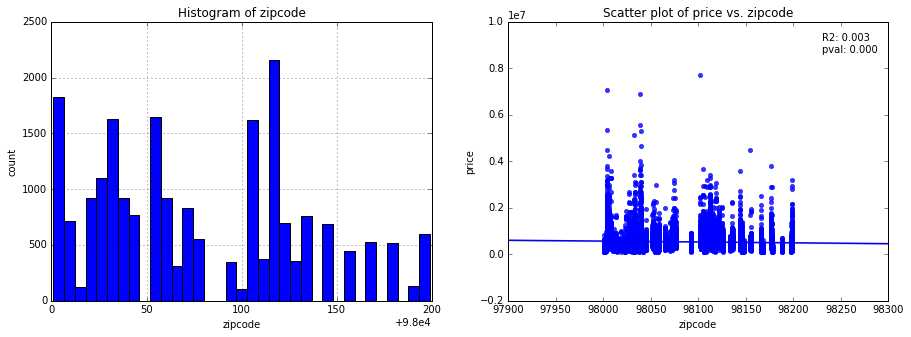

In [96]:
# Plot histogram and scatter-plot

plt.subplot(121)
df.zipcode.hist(bins=35, figsize=(15,5))
plt.title('Histogram of zipcode')
plt.xlabel('zipcode')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ zipcode', data=df).fit()

sns.regplot(x=df.zipcode, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. zipcode')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

The feature `zipcode` is a categorical variable and will be included in the regression model as such:

In [97]:
smf.ols(formula='price ~ C(zipcode)', data=df).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.407
Model:                            OLS   Adj. R-squared:                  0.405
Method:                 Least Squares   F-statistic:                     214.3
Date:                Mon, 04 Nov 2019   Prob (F-statistic):               0.00
Time:                        00:03:08   Log-Likelihood:            -3.0173e+05
No. Observations:               21596   AIC:                         6.036e+05
Df Residuals:                   21526   BIC:                         6.042e+05
Df Model:                          69                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept            2.812e+05   1.49e+04     18.859      0.000    2.52e+05     3.1e+05
C(zipcode)[T.98002] -4.691e+04    2.5e+04     -1.876      0.061   -9.59e+04    2115.031
C(zipcode)[T.98003]  1.292e+04   2.26e+04      0.573      0.567   -3.13e+04    5.71e+04
C(zipcode)[T.98004]  1.075e+06   2.18e+04     49.314      0.000    1.03e+06    1.12e+06
C(zipcode)[T.98005]  5.291e+05   2.65e+04     19.997      0.000    4.77e+05    5.81e+05
C(zipcode)[T.98006]  5.787e+05   1.96e+04     29.554      0.000     5.4e+05    6.17e+05
C(zipcode)[T.98007]  3.361e+05   2.81e+04     11.945      0.000    2.81e+05    3.91e+05
C(zipcode)[T.98008]  3.644e+05   2.25e+04     16.203      0.000     3.2e+05    4.09e+05
C(zipcode)[T.98010]  1.425e+05    3.2e+04      4.450      0.000    7.97e+04    2.05e+05
C(zipcode)[T.98011]  2.092e+05   2.52e+04      8.308      0.000     1.6e+05    2.59e+05
C(zipcode)[T.98014]  1.744e+05   2.95e+04      5.915      0.000    1.17e+05    2.32e+05
C(zipcode)[T.98019]  1.436e+05   2.54e+04      5.656      0.000    9.39e+04    1.93e+05
C(zipcode)[T.98022]  3.555e+04   2.38e+04      1.493      0.135   -1.11e+04    8.22e+04
C(zipcode)[T.98023]  5547.9418   1.96e+04      0.283      0.777   -3.28e+04    4.39e+04
C(zipcode)[T.98024]  3.049e+05    3.5e+04      8.710      0.000    2.36e+05    3.74e+05
C(zipcode)[T.98027]  3.359e+05   2.04e+04     16.445      0.000    2.96e+05    3.76e+05
C(zipcode)[T.98028]  1.813e+05   2.25e+04      8.060      0.000    1.37e+05    2.25e+05
C(zipcode)[T.98029]  3.314e+05   2.17e+04     15.251      0.000    2.89e+05    3.74e+05
C(zipcode)[T.98030]  1.499e+04   2.31e+04      0.648      0.517   -3.04e+04    6.04e+04
C(zipcode)[T.98031]  1.915e+04   2.27e+04      0.843      0.399   -2.54e+04    6.37e+04
C(zipcode)[T.98032]  -2.99e+04   2.94e+04     -1.017      0.309   -8.75e+04    2.77e+04
C(zipcode)[T.98033]  5.228e+05   2.02e+04     25.879      0.000    4.83e+05    5.62e+05
C(zipcode)[T.98034]  2.405e+05   1.92e+04     12.513      0.000    2.03e+05    2.78e+05
C(zipcode)[T.98038]   8.59e+04   1.89e+04      4.536      0.000    4.88e+04    1.23e+05
C(zipcode)[T.98039]   1.88e+06   4.27e+04     43.981      0.000     1.8e+06    1.96e+06
C(zipcode)[T.98040]  9.137e+05   2.25e+04     40.581      0.000     8.7e+05    9.58e+05
C(zipcode)[T.98042]  3.039e+04   1.92e+04      1.582      0.114   -7268.181     6.8e+04
C(zipcode)[T.98045]   1.59e+05   2.42e+04      6.564      0.000    1.12e+05    2.07e+05
C(zipcode)[T.98052]   3.64e+05    1.9e+04     19.130      0.000    3.27e+05    4.01e+05
C(zipcode)[T.98053]   3.96e+05   2.05e+04     19.290      0.000    3.56e+05    4.36e+05
C(zipcode)[T.98055]  2.307e+04   2.28e+04      1.010      0.313   -2.17e+04    6.78e+04
C(zipcode)[T.98056]  1.397e+05   2.05e+04      6.817      0.000    9.95e+04     1.8e+05
C(z

The feature `zipcode` explaines already around 40% of the variance in `price`, hence we should definitely include this variable in the final regression model. <br>
We might, however, check if we can somehow systematically group the zipcodes based on, say, the first three numbers to have a better predictor with fewer dummy-levels. After researching a zipcode-map from King County (https://washington.hometownlocator.com/zip-codes/countyzips,scfips,53033,c,king.cfm), there seems to be no easy and convenient way to group zipcodes into areas (other than by hand), so we will leave this variable as it is for now.

<h2><span style="color:red"> 
Business recommendation 4: </span> Choose the right location!</h2>

In [125]:
# create zip_dummy and add it later to the dataframe df_dummies (see above why we do this)
dummy_names.append('zip_dummy')
zip_dummy = pd.get_dummies(df.zipcode, prefix='zip', drop_first=True)
zip_dummy.head(2)

,zip_98002,zip_98003,zip_98004,zip_98005,zip_98006,zip_98007,zip_98008,zip_98010,zip_98011,zip_98014,zip_98019,zip_98022,zip_98023,zip_98024,zip_98027,zip_98028,zip_98029,zip_98030,zip_98031,zip_98032,zip_98033,zip_98034,zip_98038,zip_98039,zip_98040,zip_98042,zip_98045,zip_98052,zip_98053,zip_98055,zip_98056,zip_98058,zip_98059,zip_98065,zip_98070,zip_98072,zip_98074,zip_98075,zip_98077,zip_98092,zip_98102,zip_98103,zip_98105,zip_98106,zip_98107,zip_98108,zip_98109,zip_98112,zip_98115,zip_98116,zip_98117,zip_98118,zip_98119,zip_98122,zip_98125,zip_98126,zip_98133,zip_98136,zip_98144,zip_98146,zip_98148,zip_98155,zip_98166,zip_98168,zip_98177,zip_98178,zip_98188,zip_98198,zip_98199
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Latitude & Longitude

No handles with labels found to put in legend.


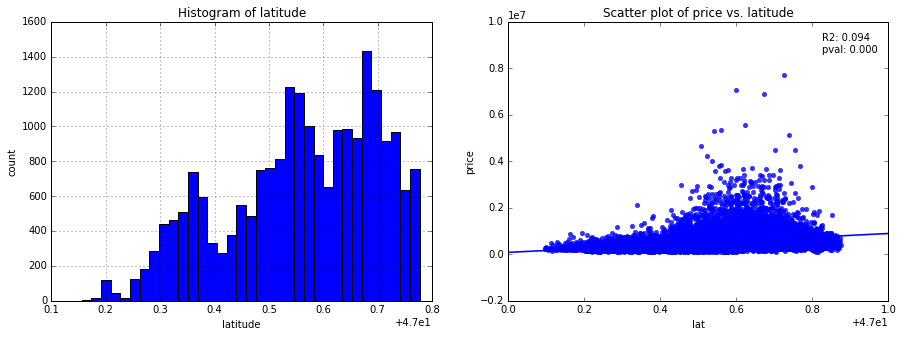

In [98]:
# Plot histogram and scatter-plot for latitude

plt.subplot(121)
df.lat.hist(bins=35, figsize=(15,5))
plt.title('Histogram of latitude')
plt.xlabel('latitude')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ lat', data=df).fit()

sns.regplot(x=df.lat, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. latitude')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

No handles with labels found to put in legend.


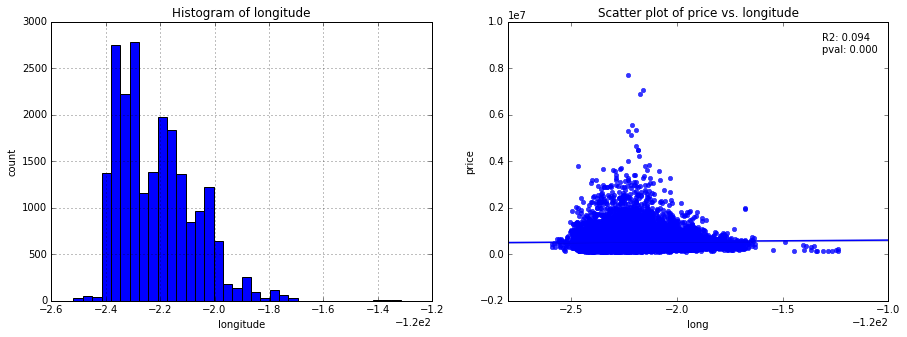

In [99]:
# Plot histogram and scatter-plot for longitude

plt.subplot(121)
df.long.hist(bins=35, figsize=(15,5))
plt.title('Histogram of longitude')
plt.xlabel('longitude')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ lat', data=df).fit()

sns.regplot(x=df.long, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. longitude')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

Conclusion: No clear linear relationship between `lat` or `long` with `price`. We might later think about combining these features for the regression using a generalized additive model, see:

- https://www.casact.org/education/rpm/2010/handouts/PM1-Guszcza.pdf
- https://stats.stackexchange.com/questions/35510/why-does-including-latitude-and-longitude-in-a-gam-account-for-spatial-autocorre

### Sqft_living15 & sqft_lot15

No handles with labels found to put in legend.


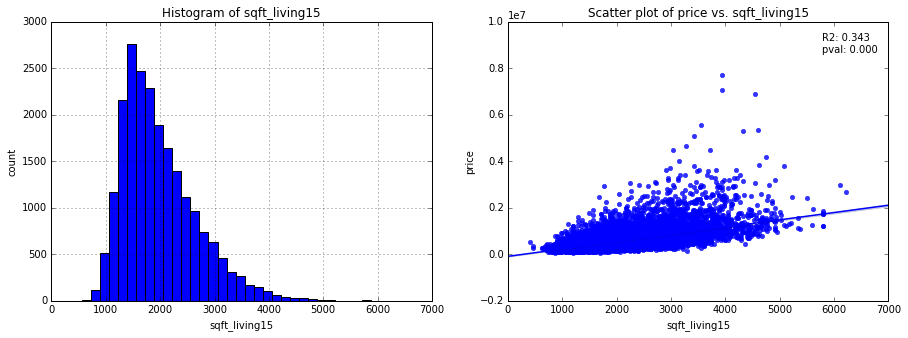

In [100]:
# Plot histogram and scatter-plot for sqft_living15

plt.subplot(121)
df.sqft_living15.hist(bins=35, figsize=(15,5))
plt.title('Histogram of sqft_living15')
plt.xlabel('sqft_living15')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_living15', data=df).fit()

sns.regplot(x=df.sqft_living15, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. sqft_living15')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

The feature `sqft_living` shows a slight linear relationship with `price`, we can include it in the model as a linear predictor.

No handles with labels found to put in legend.


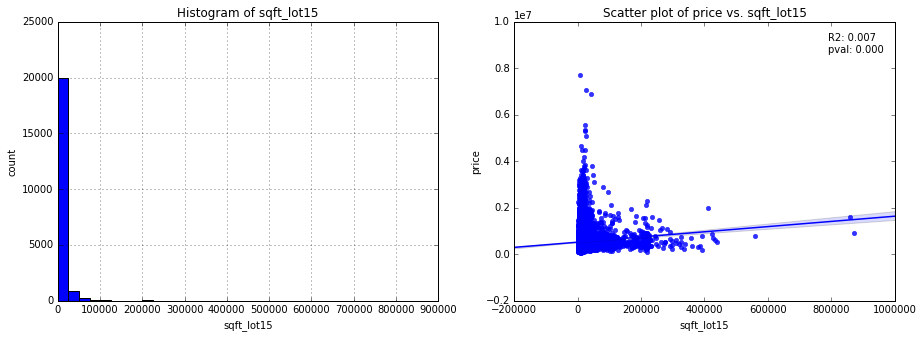

In [101]:
# Plot histogram and scatter-plot for sqft_lot15

plt.subplot(121)
df.sqft_lot15.hist(bins=35, figsize=(15,5))
plt.title('Histogram of sqft_lot15')
plt.xlabel('sqft_lot15')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ sqft_lot15', data=df).fit()

sns.regplot(x=df.sqft_lot15, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. sqft_lot15')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

The feature `sqft_living` does not show a clear linear relationship with `price`, we might bin it and include it in the model as a categorical predictor.

In [ ]:
# ToDo: Binning sqft_lot to use it as a categorical predictor?

### Date sold (day, month, year)

No handles with labels found to put in legend.


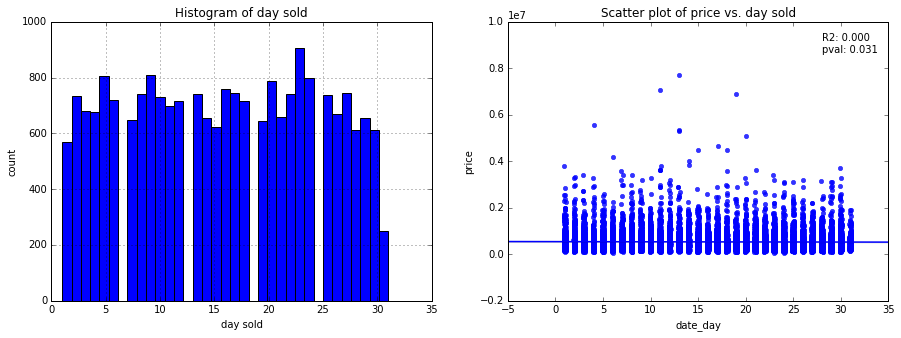

In [102]:
# Plot histogram and scatter-plot for date_day

plt.subplot(121)
df.date_day.hist(bins=35, figsize=(15,5))
plt.title('Histogram of day sold')
plt.xlabel('day sold')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ date_day', data=df).fit()

sns.regplot(x=df.date_day, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. day sold')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We can see no clear linear relationship between `date_day` and `price`. We should consider either including `date_day` as a categorical variable, or to group it into, say, weekdays (Mo-Sa) or start/middle/end of a month and then use this as a categorical predictor.

In [103]:
# date_day as categorical variable
smf.ols(formula='price ~ C(date_day)', data=df).fit().summary()  # --> very low R2 (0.003), explains <1% of price

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     1.826
Date:                Mon, 04 Nov 2019   Prob (F-statistic):            0.00380
Time:                        00:06:24   Log-Likelihood:            -3.0735e+05
No. Observations:               21596   AIC:                         6.148e+05
Df Residuals:                   21565   BIC:                         6.150e+05
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept          5.999e+05   1.54e+04     38.973      0.000     5.7e+05     6.3e+05
C(date_day)[T.2]  -5.207e+04   2.05e+04     -2.541      0.011   -9.22e+04   -1.19e+04
C(date_day)[T.3]  -5.939e+04   2.08e+04     -2.849      0.004      -1e+05   -1.85e+04
C(date_day)[T.4]   -7.32e+04   2.09e+04     -3.507      0.000   -1.14e+05   -3.23e+04
C(date_day)[T.5]  -6.423e+04   2.01e+04     -3.194      0.001   -1.04e+05   -2.48e+04
C(date_day)[T.6]  -7.794e+04   2.06e+04     -3.783      0.000   -1.18e+05   -3.76e+04
C(date_day)[T.7]  -4.398e+04   2.11e+04     -2.086      0.037   -8.53e+04   -2661.943
C(date_day)[T.8]  -4.884e+04   2.05e+04     -2.386      0.017    -8.9e+04   -8717.282
C(date_day)[T.9]  -5.353e+04   2.01e+04     -2.664      0.008   -9.29e+04   -1.41e+04
C(date_day)[T.10]  -6.12e+04   2.05e+04     -2.982      0.003   -1.01e+05    -2.1e+04
C(date_day)[T.11] -2.936e+04   2.07e+04     -1.416      0.157      -7e+04    1.13e+04
C(date_day)[T.12] -4.546e+04   2.06e+04     -2.206      0.027   -8.59e+04   -5067.203
C(date_day)[T.13] -3.012e+04   2.05e+04     -1.471      0.141   -7.02e+04       1e+04
C(date_day)[T.14] -4.542e+04    2.1e+04     -2.159      0.031   -8.67e+04   -4181.856
C(date_day)[T.15] -5.496e+04   2.13e+04     -2.581      0.010   -9.67e+04   -1.32e+04
C(date_day)[T.16]  -8.47e+04   2.04e+04     -4.160      0.000   -1.25e+05   -4.48e+04
C(date_day)[T.17] -7.485e+04   2.04e+04     -3.663      0.000   -1.15e+05   -3.48e+04
C(date_day)[T.18]  -8.31e+04   2.06e+04     -4.029      0.000   -1.24e+05   -4.27e+04
C(date_day)[T.19] -6.997e+04   2.11e+04     -3.315      0.001   -1.11e+05   -2.86e+04
C(date_day)[T.20] -5.884e+04   2.02e+04     -2.912      0.004   -9.84e+04   -1.92e+04
C(date_day)[T.21] -6.612e+04    2.1e+04     -3.146      0.002   -1.07e+05   -2.49e+04
C(date_day)[T.22] -8.089e+04   2.05e+04     -3.953      0.000   -1.21e+05   -4.08e+04
C(date_day)[T.23] -7.967e+04   1.96e+04     -4.056      0.000   -1.18e+05   -4.12e+04
C(date_day)[T.24] -7.328e+04   2.01e+04     -3.639      0.000   -1.13e+05   -3.38e+04
C(date_day)[T.25] -5.881e+04   2.05e+04     -2.871      0.004    -9.9e+04   -1.87e+04
C(date_day)[T.26] -8.041e+04   2.09e+04     -3.840      0.000   -1.21e+05   -3.94e+04
C(date_day)[T.27] -7.027e+04   2.04e+04     -3.437      0.001    -1.1e+05   -3.02e+04
C(date_day)[T.28] -6.169e+04   2.14e+04     -2.885      0.004   -1.04e+05   -1.98e+04
C(date_day)[T.29] -5.615e+04    2.1e+04     -2.670      0.008   -9.74e+04   -1.49e+04
C(date_day)[T.30] -2.581e+04   2.14e+04     -1.207      0.228   -6.77e+04    1.61e+04
C(date_day)[T.31] -5.289e+04   2.78e+04     -1.901      0.057   -1.07e+05    1643.485
==============================================================================
Omnibus:                    19056.034   Durbin-Watson:                   1.970
P

In [104]:
# create day_dummy and add it later to the dataframe df_dummies (see above why we do this)

dummy_names.append('day_dummy')
day_dummy = pd.get_dummies(df.date_day, prefix='day', drop_first=True)
day_dummy.head(3)

,day_2,day_3,day_4,day_5,day_6,day_7,day_8,day_9,day_10,day_11,day_12,day_13,day_14,day_15,day_16,day_17,day_18,day_19,day_20,day_21,day_22,day_23,day_24,day_25,day_26,day_27,day_28,day_29,day_30,day_31
0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [ ]:
# ToDo: group date_day into new categories (e.g. Mo-Sa, beginning vs. end of month, ...)

No handles with labels found to put in legend.


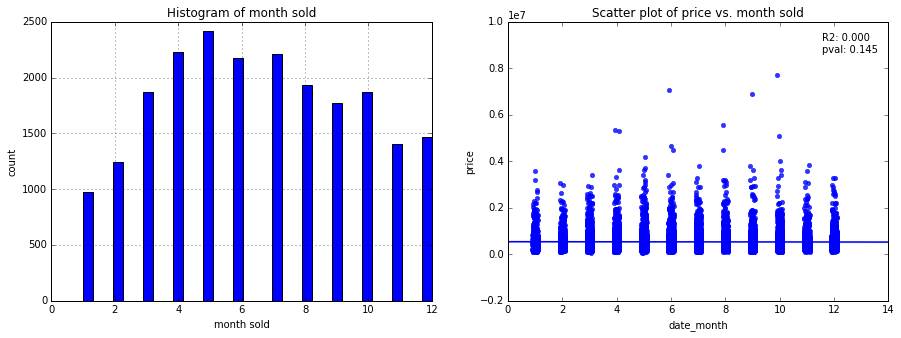

In [105]:
# Plot histogram and scatter-plot for date_month

plt.subplot(121)
df.date_month.hist(bins=35, figsize=(15,5))
plt.title('Histogram of month sold')
plt.xlabel('month sold')
plt.ylabel('count');

plt.subplot(122)
r = smf.ols(formula='price ~ date_month', data=df).fit()

sns.regplot(x=df.date_month, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. month sold')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We can also see no clear linear relationship between `date_month` and `price`. We should consider either including `date_month` as a categorical variable, or to group it into, say, seasons (spring, summer, autumn, winter) and then use this as a categorical predictor.

In [106]:
# date_month as categorical variable
smf.ols(formula='price ~ C(date_month)', data=df).fit().summary()  # --> very low R2 (0.002), explains <1% of price

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     3.067
Date:                Mon, 04 Nov 2019   Prob (F-statistic):           0.000402
Time:                        00:07:05   Log-Likelihood:            -3.0736e+05
No. Observations:               21596   AIC:                         6.147e+05
Df Residuals:                   21584   BIC:                         6.148e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept             5.26e+05   1.17e+04     44.796      0.000    5.03e+05    5.49e+05
C(date_month)[T.2]  -1.744e+04   1.57e+04     -1.112      0.266   -4.82e+04    1.33e+04
C(date_month)[T.3]   1.809e+04   1.45e+04      1.249      0.212   -1.03e+04    4.65e+04
C(date_month)[T.4]   3.625e+04   1.41e+04      2.574      0.010    8647.871    6.39e+04
C(date_month)[T.5]   2.489e+04   1.39e+04      1.788      0.074   -2393.520    5.22e+04
C(date_month)[T.6]   3.153e+04   1.41e+04      2.231      0.026    3828.338    5.92e+04
C(date_month)[T.7]   1.893e+04   1.41e+04      1.342      0.179   -8709.828    4.66e+04
C(date_month)[T.8]   1.069e+04   1.44e+04      0.742      0.458   -1.75e+04    3.89e+04
C(date_month)[T.9]   3760.2663   1.46e+04      0.257      0.797   -2.49e+04    3.24e+04
C(date_month)[T.10]  1.348e+04   1.45e+04      0.931      0.352   -1.49e+04    4.19e+04
C(date_month)[T.11] -3603.3481   1.53e+04     -0.236      0.814   -3.36e+04    2.64e+04
C(date_month)[T.12] -1163.3495   1.52e+04     -0.077      0.939   -3.09e+04    2.85e+04
==============================================================================
Omnibus:                    19114.539   Durbin-Watson:                   1.966
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1133838.453
Skew:                           4.027   Prob(JB):                         0.00
Kurtosis:                      37.572   Cond. No.                         17.3
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [107]:
# create month_dummy and add it later to the dataframe df_dummies (see above why we do this)

dummy_names.append('month_dummy')
month_dummy = pd.get_dummies(df.date_month, prefix='month', drop_first=True)
month_dummy.head(3)

,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,0,0,0,0,0,0,0,0,1,0,0
1,0,0,0,0,0,0,0,0,0,0,1
2,1,0,0,0,0,0,0,0,0,0,0


In [ ]:
# ToDo: group date_month into new categories (e.g. seasons)

No handles with labels found to put in legend.


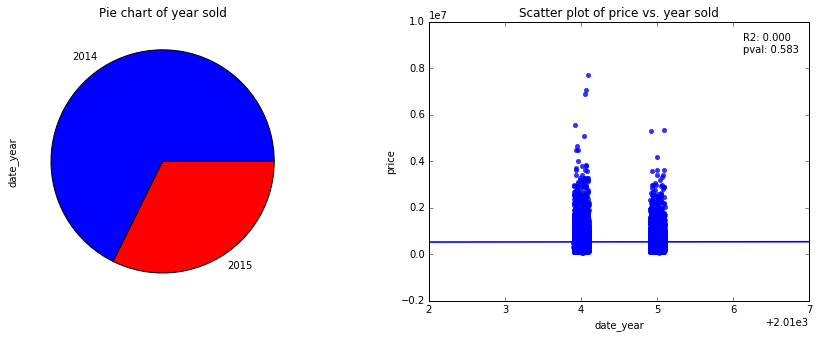

In [108]:
# Plot histogram and scatter-plot for date_year

plt.subplot(121)
df.date_year.value_counts().plot(kind='pie', colors=['blue','red'], figsize=(15,5))
plt.title('Pie chart of year sold');

plt.subplot(122)
r = smf.ols(formula='price ~ date_year', data=df).fit()

sns.regplot(x=df.date_year, y=df.price, x_jitter=0.1)
plt.title('Scatter plot of price vs. year sold')
text = 'R2: {:.3f}\npval: {:.3f}\n'.format(r.rsquared, r.pvalues[1])
plt.legend(title=text, frameon=False);

We can see no significant influence of `date_year` on `price`, we will likely leave this feature out of the regression.

In [109]:
# still, we create a year_dummy and add it later to the dataframe df_dummies (see above why we do this)
dummy_names.append('year_dummy')
year_dummy = pd.get_dummies(df.date_year, prefix='year', drop_first=True)
year_dummy.head(3)

,year_2015
0,0
1,0
2,1


## Heatmap

Next, let's look at the correlations of each continuous feature with price and which each other feature using a heatmap. This will also help us to identify highly correlated features to prevent multicollinearity. To create the heatmap, we will first make a new dataframe including only numerical (continuous) variables, and then we will only include these variables in the heatmap.

In [110]:
# show again all columns of dataframe
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'date_day', 'date_month',
       'date_year', 'renovated', 'log_sqft_lot', 'basement', 'decade_built',
       'yr_decay'],
      dtype='object')

In [111]:
# numerical variables (these will be used for the heatmap)
df_heatmap = df[['price', 'bathrooms', 'sqft_living', 'sqft_lot', 'log_sqft_lot', 'sqft_above', 
             'sqft_basement', 'grade', 'yr_built', 'yr_renovated', 'yr_decay', 
             'lat', 'long', 'sqft_living15', 'sqft_lot15']].copy()
df_heatmap.head(3)

,price,bathrooms,sqft_living,sqft_lot,log_sqft_lot,sqft_above,sqft_basement,grade,yr_built,yr_renovated,yr_decay,lat,long,sqft_living15,sqft_lot15
0,221900.0,1.00,1180,5650,8.639411,1180,0.0,7,1955,0.0,59,47.5112,-122.257,1340,5650
1,538000.0,2.25,2570,7242,8.887653,2170,400.0,7,1951,1991.0,23,47.7210,-122.319,1690,7639
2,180000.0,1.00,770,10000,9.210340,770,0.0,6,1933,NaN,82,47.7379,-122.233,2720,8062


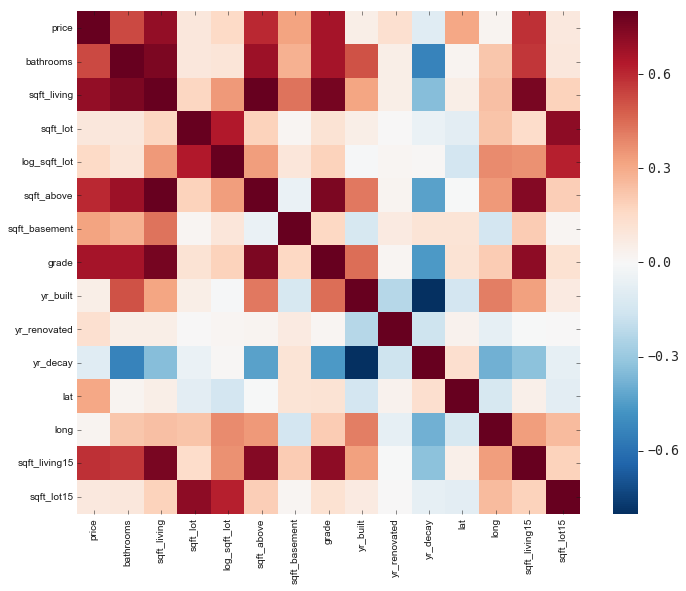

In [113]:
# Correlation matrix (Heatmap)

# calculate the correaltion matrix in numbers
corrmat = df_heatmap.corr()  

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(12, 9))

# Drawing the heatmap using seaborn (vmax/vmin: Values to anchor the colormap; square: shape of cells)
sns.set(context="paper", font="monospace", font_scale=1.5)
sns.heatmap(corrmat, vmax=.8, vmin=-.8, cmap = 'RdBu_r', square=True, annot_kws={'size': 14}); 

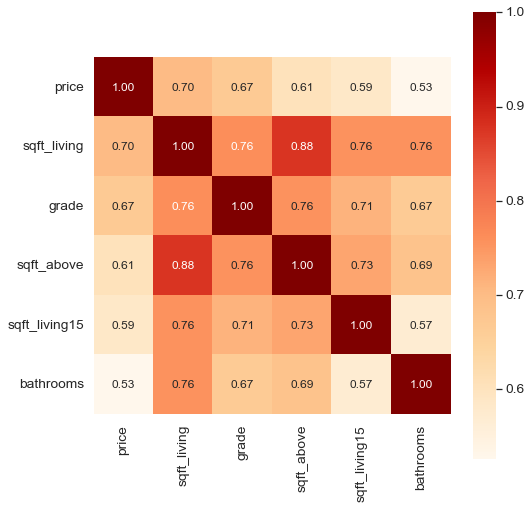

In [114]:
# price correlation matrix with only k variables for heatmap
k = 6
cols = corrmat.nlargest(k, 'price').index   # return k columns with largest correlation with SalePries
corrmat_k = df[cols].corr()
sns.set(font_scale=1.25)
cmap = sns.cubehelix_palette(8)
plt.subplots(figsize=(8, 8))
sns.heatmap(corrmat_k, fmt='.2f', annot=True, cmap = 'OrRd', square=True, annot_kws={'size': 12});

In [115]:
# let's keep these numerical variables that correlate highest with price in mind for the regression:
largest_corr = list(corrmat_k.columns[1:])
largest_corr

['sqft_living', 'grade', 'sqft_above', 'sqft_living15', 'bathrooms']

## Folium map

To better demonstrate the effect of location (zipcode) on price, we will plot a choropleth map showing the average price per zipcode. First, we download a geojson file with the namea and geographical borders (latitudes and longitudes) of King County's zipcodes.

In [116]:
# download King County's geojson file
!curl https://opendata.arcgis.com/datasets/06da0f67fc1948e3aae93063750ad02b_790.geojson --output kc_districts.geojson 
kc_geo = r'kc_districts.geojson' # geojson file
print('GeoJSON file downloaded!')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 17.6M    0 17.6M    0     0  2269k      0 --:--:--  0:00:07 --:--:-- 3357k
GeoJSON file downloaded!


Next, we read out the data contained in this geojson file and extract the zipcodes of all districts.

In [117]:
import json # library to handle JSON files
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

with open('kc_districts.geojson') as json_data:
    kc_json = json.load(json_data)
print('Done!')

Done!


In [118]:
# Get zipcodes from geojson file
kc_data = kc_json['features']
zipcodes_json = []

for data in kc_data:
    zipcode = data['properties']['ZIPCODE'] 
    zipcodes_json.append(zipcode)
    
print('The geojson file has', len(zipcodes_json), 'zipcodes.')
zipcodes_json[0:5]

The geojson file has 204 zipcodes.


['98031', '98032', '98033', '98034', '98030']

In [119]:
# Now get the mean price for each zipcode for choropleth map
zip_price = df.groupby('zipcode').mean()['price'].reset_index()
zip_price.zipcode = zip_price.zipcode.astype(str)
zip_price.head(3)

,zipcode,price
0,98001,281194.869806
1,98002,234284.035176
2,98003,294111.278571


In [120]:
# Check if all zipodes in our dataframe are also in the geojson file
all([z in zipcodes_json for z in zip_price.zipcode])

True

Now we create the choropleth map, which colors all zipcode areas based on their mean price.

In [121]:
#!pip install folium   # uncomment this line if you haven't installed folium
import folium  # map rendering library

kc_lat_long = [47.608013, -122.335167]
kc_map = folium.Map(location = kc_lat_long, tiles = 'OpenStreetMap',  zoom_start=12)

folium.Choropleth(
    geo_data='https://opendata.arcgis.com/datasets/06da0f67fc1948e3aae93063750ad02b_790.geojson',
    name='choropleth',
    data=zip_price,
    columns = ['zipcode', 'price'],
    key_on='feature.properties.ZIPCODE',
    fill_color='YlOrRd',
    fill_opacity=0.6,
    line_opacity=0.2,
    nan_fill_color='black',
    nan_fill_opacity=0, 
    legend_name='Sales prices in King County'
).add_to(kc_map)

# kc_map    # Note: does not show in Google chrome
kc_map.save('kc_choropleth_map.html')

---
# 4) Multiple Regression Model

In [123]:
# Step 1: select numerical variables used for regression and mean-center them

df_num = df[largest_corr].copy()
df_num = df_num.apply(lambda x: x-x.mean())

# if grade is included in model, also include the square of grade (after grade has been mean-centered!)
if 'grade' in df_num.columns:
    grade_c2 = df_num.grade ** 2
    grade_c2.name = 'grade_c2'
    df_num = pd.concat([df_num, grade_c2], axis=1)
    
df_num.drop('sqft_living', axis=1, inplace=True)
df_num.head(3)

,grade,sqft_above,sqft_living15,bathrooms,grade_c2
0,-0.657946,-608.631506,-646.650722,-1.115843,0.432893
1,-0.657946,381.368494,-296.650722,0.134157,0.432893
2,-1.657946,-1018.631506,733.349278,-1.115843,2.748785


In [126]:
# Step 2: select categorical variables used for regression (not mean-centered)

df_cat = pd.concat([df[['waterfront', 'basement']], floors_dummy, 
                   view_dummy, renov_dummy, zip_dummy], axis=1)
# do not include: month_dummy, cond_dummy, decade_dummy, bedrooms_dummy, day_dummy, year_dummy
df_cat.head(3)

,waterfront,basement,floor_1_5,floor_2_0,floor_2_5,floor_3_0,floor_3_5,view_1_0,view_2_0,view_3_0,view_4_0,renov_1,renova_nan,zip_98002,zip_98003,zip_98004,zip_98005,zip_98006,zip_98007,zip_98008,zip_98010,zip_98011,zip_98014,zip_98019,zip_98022,zip_98023,zip_98024,zip_98027,zip_98028,zip_98029,zip_98030,zip_98031,zip_98032,zip_98033,zip_98034,zip_98038,zip_98039,zip_98040,zip_98042,zip_98045,zip_98052,zip_98053,zip_98055,zip_98056,zip_98058,zip_98059,zip_98065,zip_98070,zip_98072,zip_98074,zip_98075,zip_98077,zip_98092,zip_98102,zip_98103,zip_98105,zip_98106,zip_98107,zip_98108,zip_98109,zip_98112,zip_98115,zip_98116,zip_98117,zip_98118,zip_98119,zip_98122,zip_98125,zip_98126,zip_98133,zip_98136,zip_98144,zip_98146,zip_98148,zip_98155,zip_98166,zip_98168,zip_98177,zip_98178,zip_98188,zip_98198,zip_98199
0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1,0.0,1.0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0.0,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [127]:
# Step 3: Combine the selected numerical and categorical variables and do a multiple regression

X = pd.concat([df_num, df_cat], axis=1)
X = sm.add_constant(X)
y = df.price

sm.OLS(y, X).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.819
Model:                            OLS   Adj. R-squared:                  0.818
Method:                 Least Squares   F-statistic:                     1116.
Date:                Mon, 04 Nov 2019   Prob (F-statistic):               0.00
Time:                        00:12:32   Log-Likelihood:            -2.8894e+05
No. Observations:               21596   AIC:                         5.781e+05
Df Residuals:                   21508   BIC:                         5.788e+05
Df Model:                          87                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          2.963e+05   8553.633     34.637      0.000     2.8e+05    3.13e+05
grade          4.266e+04   1718.965     24.819      0.000    3.93e+04     4.6e+04
sqft_above      159.3841      2.947     54.082      0.000     153.608     165.161
sqft_living15    17.4858      2.799      6.248      0.000      12.000      22.971
bathrooms      3.864e+04   2361.927     16.360      0.000     3.4e+04    4.33e+04
grade_c2       2.781e+04    530.770     52.403      0.000    2.68e+04    2.89e+04
waterfront      5.52e+05   1.55e+04     35.626      0.000    5.22e+05    5.82e+05
basement       6.676e+04   2921.231     22.853      0.000     6.1e+04    7.25e+04
floor_1_5       -1.4e+04   4205.451     -3.329      0.001   -2.22e+04   -5758.409
floor_2_0      -7.43e+04   3329.396    -22.316      0.000   -8.08e+04   -6.78e+04
floor_2_5      1.691e+04    1.3e+04      1.299      0.194   -8597.947    4.24e+04
floor_3_0     -1.331e+05   7512.132    -17.714      0.000   -1.48e+05   -1.18e+05
floor_3_5     -1.573e+04   5.95e+04     -0.264      0.792   -1.32e+05    1.01e+05
view_1_0       9.353e+04   8915.554     10.490      0.000    7.61e+04    1.11e+05
view_2_0       7.952e+04   5429.665     14.646      0.000    6.89e+04    9.02e+04
view_3_0       1.714e+05   7415.226     23.116      0.000    1.57e+05    1.86e+05
view_4_0       3.514e+05   1.11e+04     31.577      0.000     3.3e+05    3.73e+05
renov_1        6.132e+04   5983.492     10.248      0.000    4.96e+04     7.3e+04
renova_nan     1671.8825   2805.109      0.596      0.551   -3826.340    7170.105
zip_98002      1.236e+04   1.39e+04      0.890      0.373   -1.48e+04    3.96e+04
zip_98003     -5406.3630   1.25e+04     -0.432      0.665   -2.99e+04    1.91e+04
zip_98004      7.708e+05   1.22e+04     62.964      0.000    7.47e+05    7.95e+05
zip_98005      3.142e+05   1.48e+04     21.265      0.000    2.85e+05    3.43e+05
zip_98006      2.661e+05    1.1e+04     24.089      0.000    2.44e+05    2.88e+05
zip_98007        2.6e+05   1.56e+04     16.666      0.000    2.29e+05    2.91e+05
zip_98008      2.675e+05   1.25e+04     21.407      0.000    2.43e+05    2.92e+05
zip_98010      5.704e+04   1.77e+04      3.215      0.001    2.23e+04    9.18e+04
zip_98011      1.329e+05    1.4e+04      9.517      0.000    1.06e+05     1.6e+05
zip_98014      9.287e+04   1.63e+04      5.684      0.000    6.08e+04    1.25e+05
zip_98019      9.868e+04   1.41e+04      7.009      0.000    7.11e+04    1.26e+05
zip_98022      4191.5588   1.32e+04      0.317      0.751   -2.17e+04    3.01e+04
zip_98023     -3.384e+04   1.08e+04     -3.119      0.002   -5.51e+04   -1.26e+04
zip_98024      1.569e+05   1.94e+04      8.090      0.000    1.19e+05    1.95e+05
zip_98027      1.687e+05   1.14e+04     14.823      0.000    1.46e+05    1.91e+05
zip_98028      1.364e+05   1.25e+04     10.943   

In [128]:
# Step 4: Check VIF for multicollinearity

from statsmodels.stats.outliers_influence import variance_inflation_factor
vifs = pd.Series([variance_inflation_factor(X.values, i) for i in range(X.shape[1])], 
                  index=X.columns)
vifs[vifs > 5].round(1)

const         64.3
sqft_above     5.2
dtype: float64

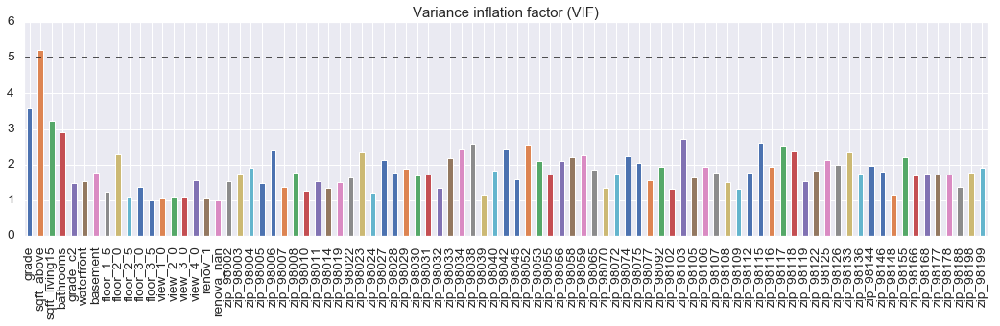

In [129]:
vifs[1:].plot(kind='bar', figsize=(18,4))  # , rot=80
plt.axhline(y=5, color='k', linestyle= '--')
plt.title('Variance inflation factor (VIF)');

Note: Multicollinearity in case of squared terms in a model, see:
- https://stats.stackexchange.com/questions/332428/regression-model-constant-causes-multicollinearity-warning-but-not-in-standardi
- "Multicollinearity is NOT a problem in your case. Multicollinearity has to be checked and problems have to be solved when you want to estimate the independent effect of two variables which happen to be correlated by chance. This is NOT your problem with your age and agesquared variables since you should never be interested in evaluating the effect of changing age without changing agesquared. So do not care about multicollinearity between one variable and a second variable which is a deterministic non linear function of the first one. Except in the case of perfect multocillinearity, which would be the case if you had only two different values for your age variable"
- "You can do a very simple thing:  1) subtract the mean of age from your original variable ; 2) after take the square of this de-meaned age; 3) regress you dependent var on the demeaned age and its square.  Now, you have reduced collinearity problem, furthermore the interpretation of the age-coefficient remains the same."

Also, VIF can be >5 for the constant (intercept), that is no problem. See:
- https://stats.stackexchange.com/questions/332428/regression-model-constant-causes-multicollinearity-warning-but-not-in-standardi

In [ ]:
# ToDo: F-test to test if groups of variables (e.g. dummies) should be taken into the model or not
# ToDo: Lasso/Ridge regression

---
# 5) Customize Plots for Business Presentation

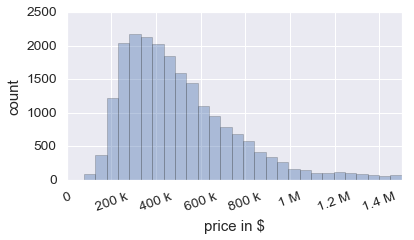

In [130]:
# 1a) House price histrogram

fig, ax = plt.subplots(figsize=(6, 3))
with sns.axes_style("white"):
    sns.distplot(df.price, bins=150, kde=False, hist_kws = dict(edgecolor='k', linewidth=0.5))
plt.xlabel('price in $')
plt.ylabel('count')
plt.xlim(0,1500000)
ax.xaxis.set_major_formatter(ticker.EngFormatter())
plt.xticks(rotation=20);

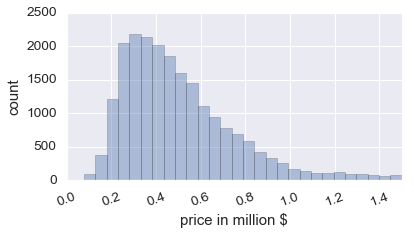

In [131]:
# 1b) House price histrogram - different x axis

fig, ax = plt.subplots(figsize=(6, 3))
with sns.axes_style("white"):
    sns.distplot(df.price/1000000, bins=150, kde=False, hist_kws = dict(edgecolor='k', linewidth=0.5))
plt.xlabel('price in million $')
plt.ylabel('count')
plt.xlim(0,1.5)
plt.xticks(rotation=20);

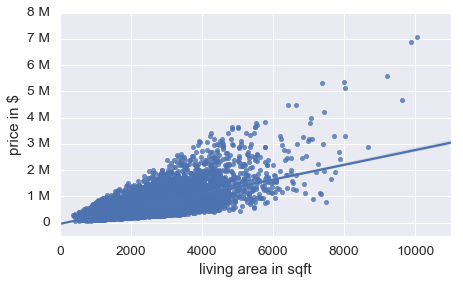

In [132]:
# 2a) Scatter plot of price vs. sqft_living

fig, ax = plt.subplots(figsize=(7, 4))
with sns.axes_style("white"):
    sns.regplot(x = 'sqft_living', y = 'price', data= df)
plt.xlabel('living area in sqft')
plt.ylabel('price in $')
plt.xlim(0,11000)
plt.ylim(-500000,8000000)
ax.yaxis.set_major_formatter(ticker.EngFormatter());

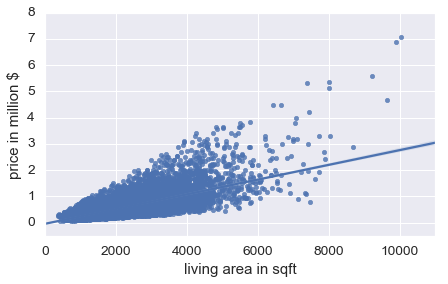

In [133]:
# 2b) Scatter plot of price vs. sqft_living - different y axis labels

fig, ax = plt.subplots(figsize=(7, 4))
with sns.axes_style("white"):
    sns.regplot(x = df.sqft_living, y = df.price/1000000, data= df)
plt.xlabel('living area in sqft')
plt.ylabel('price in million $')
plt.xlim(0,11000)
plt.ylim(-0.5,8)
ax.yaxis.set_major_formatter(ticker.EngFormatter());

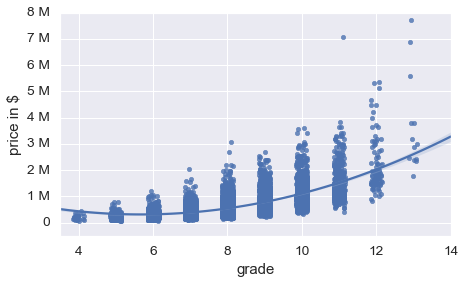

In [134]:
# 3a) Scatter plot of price vs. grade

fig, ax = plt.subplots(figsize=(7, 4))
with sns.axes_style("white"):
    sns.regplot(x = 'grade', y = 'price', data= df, order=2, x_jitter = 0.15)
plt.xlabel('grade')
plt.ylabel('price in $')
plt.xlim(3.5,14)
plt.ylim(-500000,8000000)
ax.yaxis.set_major_formatter(ticker.EngFormatter());

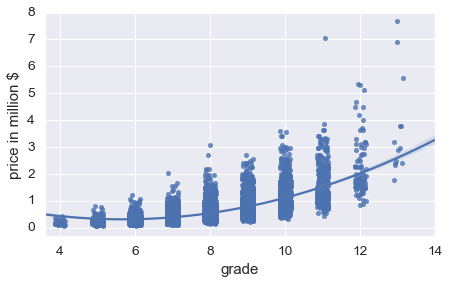

In [135]:
# 3b) Scatter plot of price vs. grade - different y axis labels

fig, ax = plt.subplots(figsize=(7, 4))
with sns.axes_style("white"):
    sns.regplot(x = df.grade, y = df.price/1000000, data= df, order=2, x_jitter = 0.15)
plt.xlabel('grade')
plt.ylabel('price in million $')
plt.xlim(3.6,14)
plt.ylim(-0.3,8)
ax.yaxis.set_major_formatter(ticker.EngFormatter());

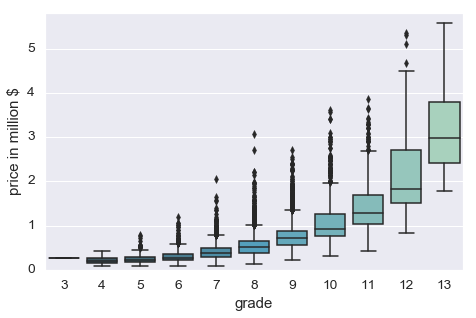

In [136]:
# 3c) Boxplot of price vs. grade

f, ax = plt.subplots(figsize=(7.5, 4.6))
fig = sns.boxplot(x=df.grade, y=df.price/1000000, palette='GnBu_d')  #, data=df)  # husl' RdBu_r
plt.ylabel('price in million $')
fig.axis(ymin=0, ymax=5.8);

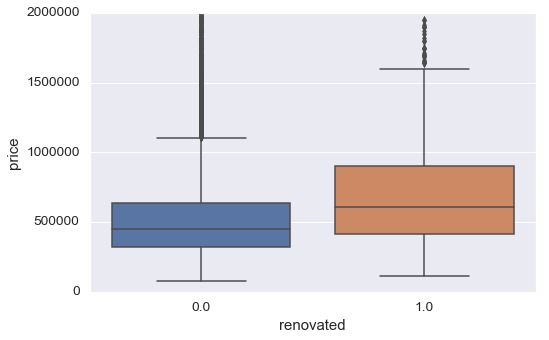

In [137]:
# 4a) Mean price for renovated (yes/no): boxplot

f, ax = plt.subplots(figsize=(8, 5))
fig = sns.boxplot(x='renovated', y='price', data=df)
fig.axis(ymin=0, ymax=2000000);

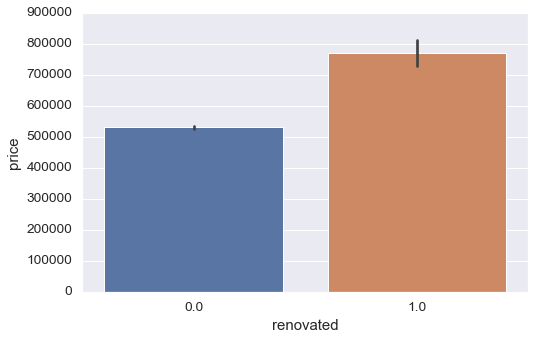

In [138]:
# 4b) Mean price for renovated (yes/no): barplot

f, ax = plt.subplots(figsize=(8, 5))
fig = sns.barplot(x='renovated', y='price', data=df)
fig.axis(ymin=0, ymax=900000);

In [139]:
# Construct variables with 'yes'/'no' instead of '0/1' for legend below
renovated_yes_no = df.renovated.copy()
renovated_yes_no.replace(0.0, 'no', inplace=True)
renovated_yes_no.replace(1.0, 'yes', inplace=True)
renovated_yes_no.value_counts()

no     17010
yes      744
Name: renovated, dtype: int64

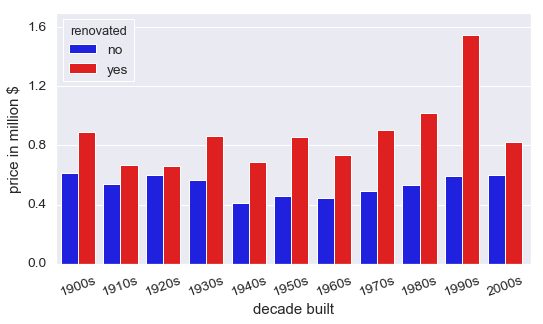

In [140]:
f, ax = plt.subplots(figsize=(8.5, 4.5))

fig = sns.barplot(x=df.decade_built, y=df.price/1000000, hue=renovated_yes_no,  # data=df, 
                  palette=['blue', 'red'], errwidth=0)   # alpha=0.8, 
fig.axis(ymin=0, ymax=1.7, xmax=10.6)
plt.xlabel('decade built')
plt.ylabel('price in million $')
plt.yticks(ticks=np.arange(0,18,4)/10)
plt.xticks(rotation=20);

---
# 6) Conclusions

**Conclusions:**
- several features were found to have a major impact on house selling prices in King County
- most important ones: location (zipcode), total living area, renovation status, house grade
- using these and further features in a multiple regression model, these predictors could together explain **>80%** of sales prices in King County

**Recommendations** (to increase sales price):

- **1) Find the right location** 
  - (e.g. for very expensive objects, choose the areas of Bellevue or Mercer Island)

- **2) Increase the interior living area of the house** 
  - (e.g. by building a winter garden, additional floors etc.)

- **3) Renovate the house** 
  - (e.g. by modernizing electricity, thermal isolation, bathrooms, ...)

- **4) Increase the grade of the house** 
  - (e.g. an upgrade from 10 to 11 can be achieved by adding amenities of solid woods and luxurious options to the house)

---
# 7) Future Work

Some prospects for future work include:

- feature engineering, i.e. taking the features we already have to build new features, which might be even better predictors of price
  - e.g. mathematical transformations like taking logarithm or inverse of a feature (see `grade` above)
  - e.g. grouping of categorical features to new meaningful categories, like combining zipcodes near or far from waterfront


- using additional location data to build new features:
  - e.g. via Foursquare or Google maps
  - use latitude and longitude to get nearby venues of a house (shops, schools, parks, …)
  
  
- Lasso/Ridge Regression for Feature Selection
   - https://towardsdatascience.com/ridge-and-lasso-regression-a-complete-guide-with-python-scikit-learn-e20e34bcbf0b
   - https://towardsdatascience.com/how-to-perform-lasso-and-ridge-regression-in-python-3b3b75541ad8
   - https://www.analyticsvidhya.com/blog/2016/01/complete-tutorial-ridge-lasso-regression-python/